# <font color='red'>3.1 Importing libraries</font>

In [1]:
# Math, image processing and other useful libraries
from __future__ import print_function, unicode_literals, absolute_import, division
import os

import pandas as pd
import numpy as np
import cv2
from collections import OrderedDict
import copy
import math
import pickle
from matplotlib.ticker import MaxNLocator
from itertools import combinations

# Image processing
from skimage.measure import regionprops
from skimage.filters import meijering, sato, frangi, hessian, threshold_otsu
from skimage.morphology import extrema, skeletonize
from skimage.transform import probabilistic_hough_line
from skimage.draw import disk, circle_perimeter
from scipy.ndimage import gaussian_filter, grey_closing
from scipy.spatial import distance_matrix
from skimage import data, restoration, util
from roipoly import RoiPoly
from matplotlib_scalebar.scalebar import ScaleBar
from biosppy.signals import tools
from biosppy.stats import pearson_correlation
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Plotting
import matplotlib.pyplot as plt
import matplotlib.cm as pltc
import matplotlib.colors as colors
import seaborn as sns

# Widgets
import ipywidgets as widgets
from ipywidgets import interact, interactive, fixed, interact_manual
from IPython.display import display

# Feature Extraction (.py files by Teresa Parreira)
# from CytoSkeletonPropsMorph import CytoSkeletonPropsMorph
# from CytoSkeletonRegionPropsInt import RegionPropsInt
# from FreqAnalysis import FreqAnalysis
# from GLCM import GLCM

# Graph
import sknw
import networkx as nx
from scipy.signal import argrelextrema

# 
from skan import Skeleton, summarize,draw
from skan.csr import skeleton_to_csgraph, sholl_analysis,make_degree_image
import scipy as sp
import scipy.sparse
from matplotlib.patches import Circle
from framework.ImageFeatures import ImageFeatures,getvoxelsize
from framework.Functions import cv2toski,pylsdtoski,polar_to_cartesian, remove_not1D, quantitative_analysis,hist_bin,hist_lim,create_separate_DFs,branch,graphAnalysis
from framework.Importing import label_image,init_import
from framework.PreProcessingCYTO import cytoskeleton_preprocessing, df_cytoskeleton_preprocessing
from framework.PreProcessingNUCL import excludeborder, nuclei_preprocessing, df_nuclei_preprocessing, nuclei_segmentation
from framework.Processing import process3Dnuclei,analyze_cell
from framework.visualization import truncate_colormap, plot_hist, plot_pie
#from fractal_dimension import fractal_dimension
#from fractal_analysis_fxns import boxcount,boxcount_grayscale,fractal_dimension,fractal_dimension_grayscale,fractal_dimension_grayscale_DBC

print('📚 All libraries successfully imported 📚')

📚 All libraries successfully imported 📚


# <font color='red'>3.2 Import and Create DataFrame with available images</font>

In [2]:
### DATASET #1 (2D)
folder    = os.path.dirname(os.getcwd()) + "\\Datasets\\Set 1-a-tubulin_Sofia"
options   = ["RGB","CYTO_DECONV","NUCL_DECONV"]

### DATASET #2 (3D)
#folder    = os.path.dirname(os.getcwd()) + "\\Datasets\\Set 3D"
#options   = ["3D"]

### DATASET #3 (Soraia)
# folder    = os.path.dirname(os.getcwd()) + "\\Datasets\\Soraia"
# options   = ["3D"]

### DATASET #4 (Inês)
# folder    = os.path.dirname(os.getcwd()) + "\\Datasets\\Ines"
#options     = []


data = init_import(folder,options)
data['NUCL_PRE'] = pd.read_pickle(folder + "\\NUCL_PRE\\NUCL_PRE.pkl") # pd.read_pickle(os.getcwd() + "\\NUCL_PRE_2D_StarDist.pkl") #
data['CYTO_PRE'] = pd.read_pickle(folder + "\\CYTO_PRE\\CYTO_PRE.pkl") 

>>> [RGB] added.
>>> [CYTO_DECONV] added.
>>> [NUCL_DECONV] added.


In [3]:
#OriginalDF
#DeconvDF
#DenoisedDF
#NoiseDF
NucleiDeconvDF
#Centroids

,Name,Label,Image
11,MAX_11_6IF_CHO_L_w3z_decon_ch00_PS.tif,WT,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
16,MAX_16_IF6_CHO_L-W1_Z_decon_ch00_PS.tif,Mock,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
18,MAX_18_IF6_CHO_L-W1_Z_decon_ch00_PS.tif,Mock,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
20,MAX_20_IF6_CHO_L-W1_Z_decon_ch00_PS.tif,Mock,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
30,MAX_30_IF6_CHO_L-W3_Z_decon_ch00_PS.tif,WT,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
34,MAX_34_IF6_CHO_L-W5_Z_decon_ch00_PS.tif,No transfection,"[[22690.0, 23518.0, 29976.0, 36203.0, 33621.0,..."
36,MAX_36_IF6_CHO_L-W5_Z_decon_ch00_PS.tif,No transfection,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
38,MAX_38_IF6_CHO_L-W5_Z_decon_ch00_PS.tif,No transfection,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
40,MAX_40_IF6_CHO_L-W6_Z_decon_ch00_PS.tif,Del38_46,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
42,MAX_42_IF6_CHO_L-W6_Z_decon_ch00_PS.tif,Del38_46,"[[15246.0, 14088.0, 14530.0, 14028.0, 0.0, 0.0..."


# <font color='red'>3.3 Image processing algorithm tester</font>

In [11]:
image = data['CYTO_DECONV']['Image'][11]
ini = image / np.max(image)
gau = gaussian_filter(ini, sigma=1)
s = sato(gau,black_ridges=False,sigmas=[1],mode='reflect') 
h = hessian(s,black_ridges=False,sigmas=[0.006],mode='reflect') 
texture = ((1 - h)!=0)*1
skeleton = skeletonize(texture)

plt.figure(figsize=(15,15)); plt.title('original');              plt.imshow(ini,cmap='gray');
plt.show()
plt.figure(figsize=(15,15)); plt.title('gaussian');              plt.imshow(gau,cmap='gray');
plt.show()
plt.figure(figsize=(15,15)); plt.title('sato');                  plt.imshow(s,cmap='gray');
plt.show()
plt.figure(figsize=(15,15)); plt.title('hessian');               plt.imshow(h,cmap='gray');
plt.show()
plt.figure(figsize=(15,15)); plt.title('texture');               plt.imshow(texture,cmap='gray');
plt.show()
plt.figure(figsize=(15,15)); plt.title('skeleton');              plt.imshow(skeleton,cmap='gray');
plt.show()

In [14]:
thresh = threshold_otsu(s)
binary_ori = s > thresh*0.2

sk = skeletonize(binary_ori) 

test3 = np.stack([sk*255,data['RGB']['Image'][INDEX][:,:,2],data['RGB']['Image'][INDEX][:,:,1]],axis=2)
ske = np.stack([sk*255,data['RGB']['Image'][INDEX][:,:,1],np.zeros_like(sk)],axis=2)

plt.figure(figsize=(15,15))
plt.imshow(test3,cmap='gray')
plt.show()

In [5]:
# -----------||
INDEX = 11     
plot  = False
# -----------||

global skeleton
%matplotlib qt
texture,skeleton = img_preprocessing(image=[OriginalDF['Image'][INDEX],INDEX], algorithm='original',parameters=[0.03,500],plot=plot)
#texture,skeleton = img_preprocessing(image=[DeconvDF['Image'][INDEX],INDEX], algorithm='new',parameters=[0.03,500],plot=plot)


print('🔎')

🔎


In [65]:
from skimage import exposure,restoration,filters




img_eq = exposure.equalize_hist(e)
hist = np.histogram(img_eq,bins=256)
plt.figure()
plt.bar(hist[1][:-1],hist[0])
plt.show()
plt.figure(figsize=(15,15)); plt.title('HIST EQ');    plt.imshow(img_eq,cmap='gray');
plt.show()
background = restoration.rolling_ball(img_eq,radius=90)
plt.figure(figsize=(15,15)); plt.title('BG');    plt.imshow(img_eq-background,cmap='gray');
plt.show()

bg = img_eq-background
thresh = threshold_otsu(bg)
binary = bg > thresh
res = binary * bg

plt.figure(figsize=(15,15)); plt.title('BG');    plt.imshow(res,cmap='gray');
plt.show()

In [69]:
plt.close('all')

# <font color='red'>3.4 Save PreProcessing Results in DataFrame</font>

In [12]:
TextureDF = pd.DataFrame(columns=['Name','Index','Label','Skeleton'])
for index,row in DeconvDF.iterrows():
    if index != 'S1':
        # Preprocessing
        texture,skeleton = img_preprocessing([row['Image'],index],  algorithm='new', parameters=[0.03,500],plot=False)

        # Add to DataFrame
        new       = pd.DataFrame(data={'Name': [row['Name']], 'Index': [index], 'Label': [label_image(index)], 'Skeleton': [skeleton]}, index = [index])
        TextureDF = TextureDF.append(new,ignore_index=False)

TextureDF

,Name,Index,Label,Skeleton
11,MAX_11_6IF_CHO_L_w3z_decon_ch02_PS.tif,11,WT,"[[False, False, False, False, False, False, Fa..."
16,MAX_16_IF6_CHO_L-W1_Z_decon_ch02_PS.tif,16,Mock,"[[False, False, False, False, False, False, Fa..."
18,MAX_18_IF6_CHO_L-W1_Z_decon_ch02_PS.tif,18,Mock,"[[False, False, False, False, False, False, Fa..."
20,MAX_20_IF6_CHO_L-W1_Z_decon_ch02_PS.tif,20,Mock,"[[False, False, False, False, False, False, Fa..."
30,MAX_30_IF6_CHO_L-W3_Z_decon_ch02_PS.tif,30,WT,"[[False, False, False, False, False, False, Fa..."
34,MAX_34_IF6_CHO_L-W5_Z_decon_ch02_PS.tif,34,No transfection,"[[False, False, False, False, False, False, Fa..."
36,MAX_36_IF6_CHO_L-W5_Z_decon_ch02_PS.tif,36,No transfection,"[[False, True, False, False, False, False, Fal..."
38,MAX_38_IF6_CHO_L-W5_Z_decon_ch02_PS.tif,38,No transfection,"[[False, False, False, False, False, False, Fa..."
40,MAX_40_IF6_CHO_L-W6_Z_decon_ch02_PS.tif,40,Del38_46,"[[False, False, False, False, False, False, Fa..."
42,MAX_42_IF6_CHO_L-W6_Z_decon_ch02_PS.tif,42,Del38_46,"[[False, True, True, True, True, True, True, F..."


# <font color='red'>3.5 Write pickle</font>

In [14]:
for index,row in TextureDF.iterrows():
    plt.figure(figsize=(15,15))
    plt.imshow(row['Skeleton'],cmap='gray')
    plt.show()

In [13]:
TextureDF.to_pickle(os.getcwd() + '\\TextureDF.pkl')  

print('Save 🥒')

Save 🥒


In [14]:
plt.close('all')

# <font color='red'>4 Individual PreProcessing</font>

In [38]:
OriginalDF.index

Int64Index([11, 16, 18, 20, 34, 36, 38, 40, 42, 44, 59, 63, 66, 70, 72, 74, 9], dtype='int64')

In [10]:
plt.figure()
plt.imshow((grey-np.mean(grey))/np.std(grey))
plt.show()

In [9]:
from scipy.ndimage import convolve
from skimage.filters import meijering, sato, frangi, hessian, threshold_otsu, laplace, threshold_yen, rank
from skimage.util import img_as_ubyte
from skimage.morphology import extrema, skeletonize, disk
from skimage import filters

# ------------------
INDEX = 11
SAVE  = False
# ------------------

# Original Image
img = data['RGB']['Image'][INDEX]

# Remove blue channel and convert to grayscale
tmp        = copy.deepcopy(img)
tmp[:,:,0] = 0
grey       = cv2.cvtColor(tmp,cv2.COLOR_RGB2GRAY)

# Yen thresholding for low intensity noise removal
thresh = threshold_yen(grey)
binary = grey > thresh*0.25
temp   = binary * grey

# Deconvolution
kernel = np.array([[-1, -1, -1],[-1, 17, -1], [-1,-1, -1]])*1/9
#kernel = np.array([[-1, -1, -1],[-1, 12, -1], [-1,-1, -1]])
#kernel = np.array([[0.17 , 0.67 , 0.17] , [0.67, 2.33 , 0.67], [0.17, 0.67, 0.17]])
#kernel = np.array([[0, -1, 0], [-1, 5,-1], [0, -1, 0]])

# Deconvolution with chosen kernel
a = cv2.filter2D(src=temp , ddepth=-1, kernel=kernel)


h = hessian(a,black_ridges=False,sigmas=[2],mode='reflect')
h = 1 - h.astype(np.uint8)

skeleton_pre = skeletonize(h)

# Contour Removal
contours, hierarchy = cv2.findContours((skeleton_pre*1).astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)  

# Filter contours with area above certain threshold
remo_contours = []
for contour in contours:
    if len(contour) <= 1:
        remo_contours.append(contour)
removed_out = np.zeros_like(h)
cv2.fillPoly(removed_out, pts = remo_contours, color=(255,255,255))

# Get final skeleton
sk = skeleton_pre*1 - removed_out/255
 


test3 = np.stack([1.3*(grey / np.max(grey)),1.5*sk*(grey / np.max(grey)), 0.4 * (data['RGB']['Image'][INDEX][:,:,0] / np.max(data['RGB']['Image'][INDEX][:,:,0]))],axis=2)
#test3 = np.stack([grey,np.zeros_like(OriginalDF['Image'][INDEX][:,:,2]),np.zeros_like(OriginalDF['Image'][INDEX][:,:,2])],axis=2)

mult = np.stack([0.9*(grey / np.max(grey)),sk*(grey / np.max(grey)), 0.4 * (data['RGB']['Image'][INDEX][:,:,0] / np.max(data['RGB']['Image'][INDEX][:,:,0]))],axis=2)
#test3 = np.stack([1.5*(grey / np.max(grey)),sk, 0.2 * (data['RGB']['Image'][INDEX][:,:,0] / np.max(data['RGB']['Image'][INDEX][:,:,0]))],axis=2)


#sk*np.max(OriginalDF['Image'][INDEX])


# Convolution
#a = convolve(temp / np.max(temp), kernel)



#gau = gaussian_filter(temp, sigma=0.1)

# Sato filter
# s = sato(a,black_ridges=False,sigmas=[3],mode='reflect') 


# #kernel = np.array([[-1, -1, -1],[-1, 12, -1], [-1,-1, -1]])
# #kernel = np.array([[0.17 , 0.67 , 0.17] , [0.67, 2.33 , 0.67], [0.17, 0.67, 0.17]])
# kernel = np.array([[0, -1, 0], [-1, 5,-1], [0, -1, 0]])


# a = cv2.filter2D(src=DeconvDF['Image'][11] , ddepth=-1, kernel=kernel)

# s = sato(a,black_ridges=False,sigmas=[1],mode='reflect') 
# thresh_ori = threshold_yen(s)
# binary_ori = s > thresh_ori*0.2
# temp       = binary_ori * s
# b = cv2.filter2D(src=temp , ddepth=-1, kernel=kernel)
# h = hessian(b,black_ridges=False,sigmas=[0.006],mode='reflect') 
# texture = ((1 - h)!=0)*1
# skeleton = skeletonize(texture)

%matplotlib qt
# plt.figure(figsize=(15,15)); plt.title('Original');                      plt.imshow(grey,cmap='gray'); 
# plt.show()
# plt.figure(figsize=(15,15)); plt.title('Otsu');                          plt.imshow(temp,cmap='gray');
# plt.show()
# plt.figure(figsize=(15,15)); plt.title('Deconvoluted');                  plt.imshow(a,cmap='gray');
# plt.show()
# plt.figure(figsize=(15,15)); plt.title('Hessian');                       plt.imshow(h,cmap='gray');
# plt.show()
# plt.figure(figsize=(15,15)); plt.title('Skeleton');                      plt.imshow(skeleton_pre,cmap='gray');
# plt.show()
# plt.figure(figsize=(15,15)); plt.title('Skeleton Processed');            plt.imshow(sk,cmap='gray');
# plt.show()
# plt.figure(figsize=(15,15)); plt.title('Removed Contours');              plt.imshow(removed_out,cmap='gray');
# plt.show()
plt.figure(figsize=(15,15));                                             plt.imshow(test3,cmap='gray');
plt.axis('off')
#plt.savefig("contest.png",format='png',transparent=True,bbox_inches='tight',dpi=800)
#plt.show()

# plt.figure(figsize=(15,15)); plt.title('Tester');                        plt.imshow(mult,cmap='gray');
# plt.show()
# plt.figure(figsize=(15,15)); plt.title('Sato -> Laplace');               plt.imshow(mult,cmap='gray');
# plt.show()
# plt.figure(figsize=(15,15)); plt.title('Laplace -> CLAHE');              plt.imshow(l,cmap='gray');
# plt.show()
# plt.figure(figsize=(15,15)); plt.title('CLAHE -> Otsu and Hyst. Thr.');  plt.imshow(minima,cmap='gray');
# plt.show()
# plt.figure(figsize=(15,15)); plt.title('Otsu and Hyst. Thr. -> Yen Thr -> * by temp -> TEXTURE'); plt.imshow(texture,cmap='gray');
# plt.show()
# plt.figure(figsize=(15,15)); plt.title('TEXTURE -> SKELETON');           plt.imshow(skeleton_pre,cmap='gray');
# plt.show()
# plt.figure(figsize=(15,15)); plt.title('SKELETON -> SKELETON FILT.');    plt.imshow(skeleton,cmap='gray');
# plt.show()



plt.savefig("contest.png",format='png',transparent=True,bbox_inches='tight',dpi=1500)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


In [6]:
data['CYTO_PRE']['Skeleton']

11    [[0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,...
16    [[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...
18    [[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...
20    [[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...
30    [[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...
34    [[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...
36    [[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...
38    [[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...
40    [[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...
42    [[0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0,...
44    [[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...
59    [[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...
63    [[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...
66    [[0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...
70    [[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...
72    [[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...
74    [[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0,...
9     [[0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0

# <font color='red'>3.6 Tests</font>

In [126]:
# Create
TextureDF = pd.DataFrame(columns=['Name','Index','Label','Skeleton'])

In [127]:
OriginalDF.index

Int64Index([11, 16, 18, 20, 34, 36, 38, 40, 42, 44, 59, 63, 66, 70, 72, 74, 9], dtype='int64')

In [145]:
from scipy.ndimage import convolve
from skimage.filters import meijering, sato, frangi, hessian, threshold_otsu, laplace, threshold_yen, rank
from skimage.util import img_as_ubyte
from skimage.morphology import extrema, skeletonize, disk
from skimage import filters

# ------------------
INDEX    = OriginalDF.index[16]
SAVE     = False
THR_FRAC = 0.9
# ------------------

# Original Image
img = OriginalDF['Image'][INDEX]

# Remove blue channel and convert to grayscale
tmp        = copy.deepcopy(img)
tmp[:,:,0] = 0
grey       = cv2.cvtColor(tmp,cv2.COLOR_RGB2GRAY)

# Yen thresholding for low intensity noise removal
thresh = threshold_yen(grey)
binary = grey > thresh*THR_FRAC
temp   = binary * grey

# Deconvolution
kernel = np.array([[-1, -1, -1],[-1, 17, -1], [-1,-1, -1]])*1/9
dec = cv2.filter2D(src=temp , ddepth=-1, kernel=kernel)


h = hessian(dec,black_ridges=False,sigmas=[2],mode='reflect')
h = 1 - h.astype(np.uint8)

skeleton_pre = skeletonize(h)

# Contour Removal
contours, hierarchy = cv2.findContours((skeleton_pre*1).astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)  

# Filter contours with area above certain threshold
remo_contours = []
for contour in contours:
    if len(contour) <= 1:
        remo_contours.append(contour)
removed_out = np.zeros_like(h)
cv2.fillPoly(removed_out, pts = remo_contours, color=(255,255,255))

# Get final skeleton
skeleton = skeleton_pre*1 - removed_out/255
 
if SAVE:
    # Add to DataFrame
    new       = pd.DataFrame(data={'Name': [OriginalDF['Name'][INDEX]], 'Index': [INDEX], 'Label': [OriginalDF['Label'][INDEX]], 'Skeleton': [skeleton]}, index = [INDEX])
    TextureDF = TextureDF.append(new,ignore_index=False)
    plt.figure()
    plt.imshow(TextureDF.loc[INDEX]['Skeleton'])
    plt.show()
TextureDF

,Name,Index,Label,Skeleton
11,10_6IF_CHO_L_w3_(DAPI+Alexa 568)_PS.tif,11,WT,"[[0.0, 0.0, 0.0, 1.0, 1.0, 1.0, 0.0, 0.0, 0.0,..."
16,15_IF6_CHO_L-W1_(DAPI+Alexa 568)_PS.tif,16,Mock,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
18,17_IF6_CHO_L-W1_(DAPI+Alexa 568)_PS.tif,18,Mock,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0,..."
20,19_IF6_CHO_L-W1_(DAPI+Alexa 568)_PS.tif,20,Mock,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
34,33_IF6_CHO_L-W5_(DAPI+Alexa 568)_PS.tif,34,No transfection,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
36,35_IF6_CHO_L-W5_(DAPI+Alexa 568)_PS.tif,36,No transfection,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
38,37_IF6_CHO_L-W5_(DAPI+Alexa 568)_PS.tif,38,No transfection,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
40,39_IF6_CHO_L-W6_(DAPI+Alexa 568)_PS.tif,40,Del38_46,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
42,41_IF6_CHO_L-W6_(DAPI+Alexa 568)_PS.tif,42,Del38_46,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
44,43_IF6_CHO_L-W6_(DAPI+Alexa 568)_PS.tif,44,Del38_46,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."


In [146]:
TextureDF.to_pickle(".//TextureDF_sub.pkl") 

In [147]:
TextureDF = pd.read_pickle(os.getcwd() + "\\TextureDF_sub.pkl")   

# <font color='red'>3.6 Tests</font>

# <font color='red'>3.6.1 Try #1</font>

In [1]:
from skimage.morphology import medial_axis, skeletonize, skeletonize_3d
from skimage.morphology import skeletonize, thin

%matplotlib qt

mult = texture * row['Image']
ya = skeletonize_3d(mult)
skel, distance = medial_axis(mult, return_distance=True)
thinned = thin(mult)
#thinned_partial = thin(image, max_iter=25)

clahe = cv2.createCLAHE(clipLimit =2.0, tileGridSize=(8,8))
cl_img = clahe.apply(row['Image'])

otsu = threshold_otsu(cl_img)
test = cl_img > otsu



plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.imshow(mult,cmap='gray')
plt.axis('off')
plt.subplot(1,2,2)
plt.imshow(row['Image'],cmap='gray')
plt.axis('off')
plt.tight_layout()
plt.show()


NameError: name 'texture' is not defined

# <font color='red'>3.6.1 Try #2</font>

In [2]:
image = row['Image'] / np.max(row['Image'])

gau = gaussian_filter(image, sigma=1)

from skimage.morphology import extrema
minima = extrema.h_minima(gau, 0.03)
minimized = gau * (1-minima)

global hessian_img
#try 1
#hessian_img = hessian(minimized,black_ridges=False,sigmas=[0.03],mode='reflect', gamma = 2000) #gamma = 2000 # 1000 demasiado proximo, 3000 demasiado fragmentado
#hessian_img = 1 - hessian_img
#try 2
hessian_img = sato(gau,black_ridges=False,sigmas=[1])
hess = hessian_img * minimized

#from skimage.morphology import footprints
from skimage.draw import ellipsoid
from scipy import ndimage
#gc = ndimage.grey_closing(hess, structure=ellipse(3,7,))



# clahe = cv2.createCLAHE(clipLimit =0.1, tileGridSize=(9,9))
# cl_img = clahe.apply((hess*255).astype(np.uint8))

from skimage import exposure
img_adapteq = exposure.equalize_adapthist(hess,clip_limit=0.1,kernel_size=(9,9))

from skimage.filters import threshold_otsu, threshold_local
binary_adaptive = threshold_local(hess, 3,'median')

from skimage import data, filters
hyst = filters.apply_hysteresis_threshold(binary_adaptive, 0.1*threshold_otsu(binary_adaptive), threshold_otsu(binary_adaptive))

from scipy import ndimage
edt = ndimage.distance_transform_edt(binary_adaptive)

skel = skeletonize_3d(binary_adaptive)

plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.imshow(hess,cmap='gray') #row['Image']
plt.axis('off')
plt.subplot(1,2,2)
plt.imshow(hessian_img * row['Image'],cmap='gray')
plt.axis('off')
plt.tight_layout()
plt.show()


NameError: name 'row' is not defined

# <font color='red'>3.6.1 Try #3</font>

In [9]:
%matplotlib qt
image = row['Image'] / np.max(row['Image'])

gau = gaussian_filter(image, sigma=1)

h_direct = 1 - hessian(gau,black_ridges=False,sigmas=[0.003],mode='reflect') 

s = sato(gau,black_ridges=False,sigmas=[1],mode='reflect')

h = hessian(s,black_ridges=False,sigmas=[0.006],mode='reflect') 
h = ((1 - h)!=0)*1

h_fim = h * row['Image']
#h = threshold_local(h, 3,'median')

#h_thin = thin(h_fim)
#skel3 = skeletonize_3d(h_fim)
#skel3 = skeletonize_3d(2.*(h_fim - np.min(h_fim))/np.ptp(h_fim)-1)
skel = skeletonize(h)

plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.imshow(skel,cmap='gray') #row['Image']
plt.axis('off')
plt.subplot(1,2,2)
plt.imshow(h_fim,cmap='gray')
plt.axis('off')
plt.tight_layout()
plt.show()

# <font color='red'>3.6.1 Try #4</font>

In [ ]:
# Histogram Equalization of RGB image
LAB          = copy.deepcopy(image[0])
LAB[:,:,0]   = 0
lab          = cv2.cvtColor(LAB, cv2.COLOR_BGR2LAB)
clahe        = cv2.createCLAHE(clipLimit =0.1, tileGridSize=(30,30))
lab[:,:,0]   = clahe.apply(lab[:,:,0])
enhanced_img = cv2.cvtColor(lab, cv2.COLOR_LAB2BGR)

# Convert to gray, Gaussian Filter
gra          = cv2.cvtColor(enhanced_img,cv2.COLOR_RGB2GRAY)

ori_g = gaussian_filter(gra, sigma=1)
thresh_ori = threshold_otsu(ori_g)
binary_ori = gra > thresh_ori*0.8
temp = binary_ori * gra

# # Contour Detection
# contours, hierarchy = cv2.findContours(temp, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)  

# # Filter contours with area above certain threshold
# filt_contours = []
# remo_contours = []
# for contour in contours:
#     if cv2.contourArea(contour) > 3:
#         filt_contours.append(contour)
#     else:
#         remo_contours.append(contour)

# # Draw contours
# contour_out = np.zeros_like(temp)
# removed_out = np.zeros_like(contour_out)
# cv2.drawContours(contour_out, filt_contours, -1, 255, 3)
# cv2.drawContours(removed_out, remo_contours, -1, 255, 3)

# # Draw inside contour lines
# contour_int = np.zeros_like(temp) 
# cv2.fillPoly(contour_int, pts = filt_contours, color=(255,255,255))

# # WATERSHED

# closed = area_closing(contour_int, 10000)

# distance = ndi.distance_transform_edt(closed)
# coords = peak_local_max(distance, footprint=np.ones((200, 200)), labels=closed)
# mask = np.zeros(distance.shape, dtype=bool)
# mask[tuple(coords.T)] = True

# markers, _ = ndi.label(mask)

# markers = np.zeros_like(temp)
# l = 1
# for index,row_ in Centroids[INDEX].iterrows():
#     markers[int(row_['Centroid'][0]),int(row_['Centroid'][1])] = l
#     l+=1
    
# labels = watershed(-distance, markers, mask=closed)

gau = gaussian_filter(temp, sigma=1)
s = sato(gau,black_ridges=False,sigmas=[3],mode='reflect') 
h = hessian(s,black_ridges=False,sigmas=[0.01],mode='reflect') 
texture = ((1 - h)!=0)*1

skeleton = skeletonize(texture)



# Contour Detection
contours, hierarchy = cv2.findContours((skeleton*1).astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)  

# Filter contours with area above certain threshold
remo_contours = []
for contour in contours:
    if len(contour) <= 3:
        remo_contours.append(contour)
        
# Draw contours
contour_out = np.zeros_like(texture)

removed_out = np.zeros_like(texture)
cv2.fillPoly(removed_out, pts = remo_contours, color=(255,255,255))

# Get final skeleton
FINAL = skeleton*1 - removed_out/255
# # Draw inside contour lines
# contour_int = np.zeros_like(texture) 
# cv2.fillPoly(contour_int, pts = filt_contours, color=(255,255,255))
# cv2.drawContours(contour_int, filt_contours, -1, 0, 3)



---

In [50]:
from skimage import feature
#edges = cv2.Canny(s,100,200)
edges = feature.canny(s, sigma=0.00001,low_threshold=np.min(s),high_threshold=np.max(s))

from scipy import ndimage
c = ndimage.binary_fill_holes(edges)

plt.imshow(skeletonize(edges),cmap='gray')

In [51]:
lsd   = cv2.createLineSegmentDetector(cv2.LSD_REFINE_ADV,2.5,0.001,0,90,-200,0.5,2048)
lines = cv2toski(lsd.detect((skel * 255).astype(np.uint8))[0])
    

In [58]:
plt.figure()
plt.imshow(skeletonize(edges),alpha = 0.2,cmap='gray')
for line in lines:
    p0,p1 = line
    plt.plot((p0[0], p1[0]), (p0[1], p1[1]),'r')
plt.show()

In [57]:
plt.figure()
plt.imshow(skel,cmap='gray')

In [46]:
plt.figure()
plt.imshow(edges,cmap='gray')

**testar lsd ou prob hough com h e skel**

In [16]:
import sknw



graph = sknw.build_sknw(skel)

# draw image
plt.figure()
plt.imshow(np.zeros_like(skel), cmap='gray')

# draw edges by pts
for (s,e) in graph.edges():
    ps = graph[s][e]['pts']
    plt.plot(ps[:,1], ps[:,0], 'green')
    
# draw node by o
nodes = graph.nodes()
ps = np.array([nodes[i]['o'] for i in nodes])
plt.plot(ps[:,1], ps[:,0], 'r.')

# title and show
plt.title('Build Graph')
plt.show()

In [242]:
plt.imshow(skel,cmap='gray')

In [265]:
from skimage.morphology import footprints
footprints.ellipse(5, 3)

ImportError: cannot import name 'footprints' from 'skimage.morphology' (C:\Users\diogo\anaconda3\envs\Cytoskeleton\lib\site-packages\skimage\morphology\__init__.py)

In [106]:
help(cv2.createLineSegmentDetector)

Help on built-in function createLineSegmentDetector:

createLineSegmentDetector(...)
    createLineSegmentDetector([, refine[, scale[, sigma_scale[, quant[, ang_th[, log_eps[, density_th[, n_bins]]]]]]]]) -> retval
    .   @brief Creates a smart pointer to a LineSegmentDetector object and initializes it.
    .   
    .   The LineSegmentDetector algorithm is defined using the standard values. Only advanced users may want
    .   to edit those, as to tailor it for their own application.
    .   
    .   @param refine The way found lines will be refined, see #LineSegmentDetectorModes
    .   @param scale The scale of the image that will be used to find the lines. Range (0..1].
    .   @param sigma_scale Sigma for Gaussian filter. It is computed as sigma = sigma_scale/scale.
    .   @param quant Bound to the quantization error on the gradient norm.
    .   @param ang_th Gradient angle tolerance in degrees.
    .   @param log_eps Detection threshold: -log10(NFA) \> log_eps. Used only when a

In [79]:
help(lsd.detect)

Help on built-in function detect:

detect(...) method of cv2.LineSegmentDetector instance
    detect(image[, lines[, width[, prec[, nfa]]]]) -> lines, width, prec, nfa
    .   @brief Finds lines in the input image.
    .   
    .       This is the output of the default parameters of the algorithm on the above shown image.
    .   
    .       ![image](pics/building_lsd.png)
    .   
    .       @param image A grayscale (CV_8UC1) input image. If only a roi needs to be selected, use:
    .       `lsd_ptr-\>detect(image(roi), lines, ...); lines += Scalar(roi.x, roi.y, roi.x, roi.y);`
    .       @param lines A vector of Vec4f elements specifying the beginning and ending point of a line. Where
    .       Vec4f is (x1, y1, x2, y2), point 1 is the start, point 2 - end. Returned lines are strictly
    .       oriented depending on the gradient.
    .       @param width Vector of widths of the regions, where the lines are found. E.g. Width of line.
    .       @param prec Vector of precisions

In [152]:
import dis
dis.dis(lsd.detect)

TypeError: don't know how to disassemble builtin_function_or_method objects

In [153]:
import inspect
inspect.getsource(cv2.createLineSegmentDetector)


TypeError: module, class, method, function, traceback, frame, or code object was expected, got builtin_function_or_method

In [127]:
%matplotlib qt
plt.imshow(skeleton)

In [147]:
help(cv2.createLineSegmentDetector)

Help on built-in function createLineSegmentDetector:

createLineSegmentDetector(...)
    createLineSegmentDetector([, refine[, scale[, sigma_scale[, quant[, ang_th[, log_eps[, density_th[, n_bins]]]]]]]]) -> retval
    .   @brief Creates a smart pointer to a LineSegmentDetector object and initializes it.
    .   
    .   The LineSegmentDetector algorithm is defined using the standard values. Only advanced users may want
    .   to edit those, as to tailor it for their own application.
    .   
    .   @param refine The way found lines will be refined, see #LineSegmentDetectorModes
    .   @param scale The scale of the image that will be used to find the lines. Range (0..1].
    .   @param sigma_scale Sigma for Gaussian filter. It is computed as sigma = sigma_scale/scale.
    .   @param quant Bound to the quantization error on the gradient norm.
    .   @param ang_th Gradient angle tolerance in degrees.
    .   @param log_eps Detection threshold: -log10(NFA) \> log_eps. Used only when a

In [ ]:
    #2nd option
    #lines = probabilistic_hough_line(patch, threshold=hough_params[0], line_length=int(hough_params[1]), line_gap=hough_params[2],theta = np.linspace(-np.pi / 2, np.pi / 2, 360, endpoint=True),seed=100)
    
    # others
    #lines = probabilistic_hough_line(text_img[0], threshold=hough_params[0], line_length=hough_params[1], line_gap=hough_params[2], theta = np.linspace(-np.pi / 2, np.pi / 2, 720, endpoint=False))
    #lines = cv2toski(cv2.HoughLinesP(patch.astype(np.uint8), rho=1., theta=np.pi/180., threshold=hough_params[0], minLineLength=hough_params[1], maxLineGap=hough_params[2]))
    #lines = probabilistic_hough_line(patch, threshold=hough_params[0], line_length=hough_params[1], line_gap=hough_params[2], theta = np.linspace(-np.pi / 2, np.pi / 2, 720, endpoint=False))
    #lines = cv2toski(cv2.HoughLinesP((255*patch).astype(np.uint8), rho=150, theta=np.pi/180., threshold=2, minLineLength=1, maxLineGap=0))
    
    # LAST   SCALE = 2.5!!!! 1) 3.5 (radial) 2) losango 3


In [158]:
from PIL import Image
ROIs = pickle.load(open('ROIs.p', 'rb'))

n = 0
for index,row in ROIs.iterrows():
    try:
        # Get Texture / Skeleton (might need an "if" statement for synthetic)
        global texture,skeleton
        TextureDF = pd.DataFrame(columns=['Name','Label','Image'])
        texture,skeleton,TextureDF = img_getTexture([row['ROImask'] * DeconvDF['Image'][row['Index']],row['Index'],row['Name'],row['Label']], sigmas=[0.03], gamma=500, algorithm='new',TextureDF=TextureDF,to_add='skeleton')

        global x_,y_,patch
        x_,y_   = np.where(skeleton * 1 != 0)
        patch   = skeleton[min(x_):max(x_),min(y_):max(y_)]

        im = Image.fromarray(patch * 255)
        im.save(str(n) + ".png")
    except:
        continue

    # Print progress
    print(n,(n / len(ROIs))*100)
    n += 1


0 0.0
1 0.0946969696969697
2 0.1893939393939394
3 0.2840909090909091
4 0.3787878787878788
5 0.4734848484848485
6 0.5681818181818182
7 0.6628787878787878
8 0.7575757575757576
9 0.8522727272727272
10 0.946969696969697
11 1.0416666666666665
12 1.1363636363636365
13 1.231060606060606
14 1.3257575757575757
15 1.4204545454545454
16 1.5151515151515151
17 1.6098484848484849
18 1.7045454545454544
19 1.7992424242424243
20 1.893939393939394
21 1.9886363636363635
22 2.083333333333333
23 2.178030303030303
24 2.272727272727273
25 2.367424242424242
26 2.462121212121212
27 2.556818181818182
28 2.6515151515151514
29 2.746212121212121
30 2.840909090909091
31 2.9356060606060606
32 3.0303030303030303
33 3.125
34 3.2196969696969697
35 3.3143939393939394
36 3.4090909090909087
37 3.5037878787878785
38 3.5984848484848486
39 3.6931818181818183
40 3.787878787878788
41 3.882575757575758
42 3.977272727272727
43 4.071969696969697
44 4.166666666666666
45 4.261363636363636
46 4.356060606060606
47 4.450757575757576
4

ipykernel_launcher.py (95): invalid value encountered in true_divide


320 30.303030303030305
321 30.39772727272727
322 30.492424242424242
323 30.58712121212121
324 30.681818181818183
325 30.77651515151515
326 30.87121212121212
327 30.96590909090909
328 31.060606060606062
329 31.155303030303028
330 31.25
331 31.344696969696972
332 31.439393939393938
333 31.53409090909091
334 31.62878787878788
335 31.72348484848485
336 31.818181818181817
337 31.91287878787879
338 32.00757575757576
339 32.10227272727273
340 32.196969696969695
341 32.29166666666667
342 32.38636363636363
343 32.48106060606061
344 32.57575757575758
345 32.67045454545455
346 32.765151515151516
347 32.859848484848484
348 32.95454545454545
349 33.04924242424242
350 33.14393939393939
351 33.23863636363637
352 33.33333333333333
353 33.428030303030305
354 33.52272727272727
355 33.61742424242424
356 33.71212121212121
357 33.80681818181818
358 33.90151515151515
359 33.996212121212125
360 34.090909090909086
361 34.18560606060606
362 34.28030303030303
363 34.375
364 34.46969696969697
365 34.564393939393

696 65.9090909090909
697 66.00378787878788
698 66.09848484848484
699 66.19318181818183
700 66.28787878787878
701 66.38257575757575
702 66.47727272727273
703 66.5719696969697
704 66.66666666666666
705 66.76136363636364
706 66.85606060606061
707 66.95075757575758
708 67.04545454545455
709 67.14015151515152
710 67.23484848484848
711 67.32954545454545
712 67.42424242424242
713 67.51893939393939
714 67.61363636363636
715 67.70833333333334
716 67.8030303030303
717 67.89772727272727
718 67.99242424242425
719 68.08712121212122
720 68.18181818181817
721 68.27651515151516
722 68.37121212121212
723 68.4659090909091
724 68.56060606060606
725 68.65530303030303
726 68.75
727 68.84469696969697
728 68.93939393939394
729 69.0340909090909
730 69.12878787878788
731 69.22348484848484
732 69.31818181818183
733 69.41287878787878
734 69.50757575757575
735 69.60227272727273
736 69.6969696969697
737 69.79166666666666
738 69.88636363636364
739 69.98106060606061
740 70.07575757575758
741 70.17045454545455
742 70

In [20]:
def parameters(scale,sigma_scale,quant,ang_th,log_eps,density,n_bins):
    #im = skel[515:665,600:720]
    im = skel[50:320,150:400]
    lsd = cv2.createLineSegmentDetector(cv2.LSD_REFINE_ADV,scale,sigma_scale,quant,ang_th,log_eps,density,n_bins)
    lines = cv2toski(lsd.detect((im * 255).astype(np.uint8))[0])
    global prec,width
    prec = lsd.detect((im * 255).astype(np.uint8))[2]
    width = lsd.detect((im * 255).astype(np.uint8))[1]

    %matplotlib qt
    plt.figure(figsize=(10,10))
    plt.imshow(im,cmap='gray')
    ind = 0
    for line in lines:
        p0, p1 = line
        cmap = pltc.cool
        plt.plot((p0[0], p1[0]), (p0[1], p1[1]),linewidth=2,color=cmap(plt.Normalize(0, 1)(prec[ind])))
        ind = ind + 1
        plt.tight_layout()

    plt.axis('off')
    print('done')
    plt.show()

interact(parameters,scale=2.5,sigma_scale=0.001,quant=0,ang_th=90,log_eps=-200,density=0.5,n_bins=2048)

interactive(children=(FloatSlider(value=2.5, description='scale', max=7.5, min=-2.5), FloatSlider(value=0.001,…

<function __main__.parameters(scale, sigma_scale, quant, ang_th, log_eps, density, n_bins)>

In [141]:
im = skel[50:320,150:400]

best_ang = -1
best_den = -1
best = 0
for ang_th in np.arange(50,100,10):
    for den in np.arange(0,0.8,0.1):
        lsd = cv2.createLineSegmentDetector(cv2.LSD_REFINE_ADV,2.5,0.001,0,ang_th,-200,den,2048)
        
        global prec
        prec = lsd.detect((im * 255).astype(np.uint8))[2]
        
        if np.mean(prec) > best:
            best_ang = ang_th
            best_den = den
            
best_lsd = cv2.createLineSegmentDetector(cv2.LSD_REFINE_ADV,2.5,0.001,0,best_ang,-200,best_den,2048)
lines = cv2toski(best_lsd.detect((im * 255).astype(np.uint8))[0])
prec = best_lsd.detect((im * 255).astype(np.uint8))[2]

%matplotlib qt
plt.figure(figsize=(10,10))
plt.imshow(im,cmap='gray')
ind = 0
for line in lines:
    p0, p1 = line
    cmap = pltc.cool
    plt.plot((p0[0], p1[0]), (p0[1], p1[1]),linewidth=2,color=cmap(plt.Normalize(0, 1)(prec[ind])))
    ind = ind + 1
    plt.tight_layout()

plt.axis('off')
print('done')
plt.show()
        

done


In [140]:
def parameters(sigmas):
    %matplotlib qt
    
    s = sato(gau,black_ridges=False,sigmas=[sigmas]) 

    plt.figure(figsize=(15,15))
    plt.subplot(1,2,1)
    plt.imshow(row['Image'],cmap='gray') #row['Image']
    plt.axis('off')
    plt.subplot(1,2,2)
    plt.imshow(s,cmap='gray')
    plt.axis('off')
    plt.tight_layout()
    plt.show()



plt.figure(figsize=(10,10))
interact(parameters, sigmas=(0.01,2,0.05) );


interactive(children=(FloatSlider(value=0.9600000000000001, description='sigmas', max=2.0, min=0.01, step=0.05…

In [142]:
plt.imshow(,cmap='gray')

In [143]:
np.unique((h!=0)*1)

array([0, 1])

In [ ]:
from scipy import ndimage
kas = ndimage.distance_transform_edt(binary_adaptive)

plt.imshow(kas)

In [ ]:
ellipse(3,7)

In [66]:
footprint1 = [[0,0,0],[1,1,1],[0,0,0]]
footprint2 = [[0,1,0],[0,1,0],[0,1,0]]
footprint3 = [[1,0,0],[0,1,0],[0,0,1]]
footprint4 = [[0,0,1],[0,1,0],[1,0,0]]
footps = [footprint1,footprint2,footprint3,footprint4]

In [126]:
gc == cl_img / np.max(cl_img)

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

In [101]:
np.unique(minimized)

array([0.00000000e+00, 6.01257334e-12, 9.83875638e-12, ...,
       9.72649282e-01, 9.72793276e-01, 9.72973385e-01])

In [78]:
np.max(gau * minima)

0.7542870073364191

In [60]:
plt.imshow(hessian_img,cmap='gray')

In [6]:
from skimage.filters import threshold_otsu, threshold_local
binary_adaptive = threshold_local(TextureDF['Image'][9], 3,'median')
#o = grey_closing(TextureDF['Image'][11], size=(5,5))
otsu = threshold_otsu(binary_adaptive)
bini = binary_adaptive > otsu

plt.figure(figsize=(15,25))
plt.subplot(2,1,1)
plt.imshow(TextureDF['Image'][9],cmap='gray')
plt.subplot(2,1,2)
plt.imshow(bini,cmap='gray')

IndexError: index 9 is out of bounds for axis 0 with size 0

In [10]:
def truncate_colormap(cmap, minval=0.0, maxval=1.0, n=100):
    new_cmap = colors.LinearSegmentedColormap.from_list(
        'trunc({n},{a:.2f},{b:.2f})'.format(n=cmap.name, a=minval, b=maxval),
        cmap(np.linspace(minval, maxval, n)))
    return new_cmap

In [8]:
f = 9
texture, skeleton, filt_contours, contour_out, contour_int,TextureDF = img_getTexture([(255*(DeconvDF['Image'][f]/np.max(DeconvDF['Image'][f]))).astype(np.uint8),9,TextureDF['Name'][f],TextureDF['Label'][f]], sigmas=[0.03], gamma=500, algorithm='contour',TextureDF=TextureDF,to_add='null')
#texture, skeleton, filt_contours, contour_out, contour_int,TextureDF = img_getTexture([255*TextureDF['Image'][f],9,TextureDF['Name'][f],TextureDF['Label'][f]], sigmas=[0.03], gamma=500, algorithm='contour',TextureDF=TextureDF,to_add='null')

ImageLinesDF = pd.DataFrame(columns = ['Name'] + ['Label'] + ['Angles'] + ['Distances to Centroid'] + ['Triangle Areas'] + ['Line Lengths'] + ['Fractal Dim'])
ImageLinesDF = analyze_contour(filt_contours[7],1,[texture,f],[0,2,1],Centroids[f]['Centroid'],ImageLinesDF,True)


NameError: name 'Centroids' is not defined

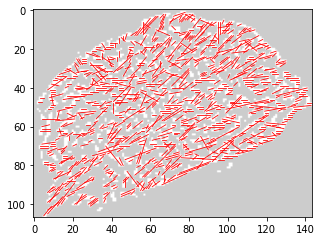

In [170]:
analyze_contour(filt_contours[5],[texture,index],[0,2,1],True)

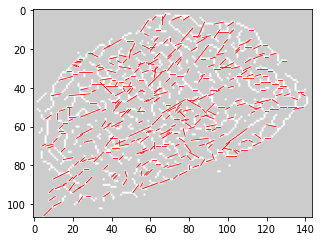

In [220]:
analyze_contour(filt_contours[5],[skeleton*1,index],[0,2,1],True)

In [162]:
distance.min()

-1.7976931348623157e+308

In [299]:
OriginalDF.index

Int64Index([11, 16, 18, 20, 34, 36, 38, 40, 42, 44, 59, 63, 66, 70, 72, 74, 9], dtype='int64')

# TEST 1 - w/ CLAHE

In [ ]:
USAR CLAHE NO LAB É ASSIM TAO VANTAJOSO?

In [388]:
INDEX = 11
LABTEST = copy.deepcopy(OriginalDF['Image'][INDEX])
LABTEST[:,:,0] = 0
lab    = cv2.cvtColor(LABTEST, cv2.COLOR_BGR2LAB)
clahe  = cv2.createCLAHE(clipLimit =0.1, tileGridSize=(30,30))
lab[:,:,0] = clahe.apply(lab[:,:,0])
enhanced_img = cv2.cvtColor(lab, cv2.COLOR_LAB2BGR)
gra = cv2.cvtColor(enhanced_img,cv2.COLOR_RGB2GRAY)



ori_g = gaussian_filter(gra, sigma=0.1)
thresh_ori = threshold_otsu(ori_g)
binary_ori = gra > thresh_ori*0.8
temp = binary_ori * gra

# # Contour Detection
# contours, hierarchy = cv2.findContours(temp, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)  

# # Filter contours with area above certain threshold
# filt_contours = []
# remo_contours = []
# for contour in contours:
#     if cv2.contourArea(contour) > 3:
#         filt_contours.append(contour)
#     else:
#         remo_contours.append(contour)

# # Draw contours
# contour_out = np.zeros_like(temp)
# removed_out = np.zeros_like(contour_out)
# cv2.drawContours(contour_out, filt_contours, -1, 255, 3)
# cv2.drawContours(removed_out, remo_contours, -1, 255, 3)

# # Draw inside contour lines
# contour_int = np.zeros_like(temp) 
# cv2.fillPoly(contour_int, pts = filt_contours, color=(255,255,255))

# # WATERSHED

# closed = area_closing(contour_int, 10000)

# distance = ndi.distance_transform_edt(closed)
# coords = peak_local_max(distance, footprint=np.ones((200, 200)), labels=closed)
# mask = np.zeros(distance.shape, dtype=bool)
# mask[tuple(coords.T)] = True

# markers, _ = ndi.label(mask)

# markers = np.zeros_like(temp)
# l = 1
# for index,row_ in Centroids[INDEX].iterrows():
#     markers[int(row_['Centroid'][0]),int(row_['Centroid'][1])] = l
#     l+=1
    
# labels = watershed(-distance, markers, mask=closed)

gau = gaussian_filter(temp, sigma=1)
s = sato(gau,black_ridges=False,sigmas=[3],mode='reflect') 


h = hessian(s,black_ridges=False,sigmas=[0.01],mode='reflect') 
texture = ((1 - h)!=0)*1

skeleton = skeletonize(texture)



# Contour Detection
contours, hierarchy = cv2.findContours((skeleton*1).astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)  

# Filter contours with area above certain threshold
remo_contours = []
for contour in contours:
    if len(contour) <= 3:
        remo_contours.append(contour)
        
# Draw contours
contour_out = np.zeros_like(texture)

removed_out = np.zeros_like(texture)
cv2.fillPoly(removed_out, pts = remo_contours, color=(255,255,255))

# Get final skeleton
FINAL = skeleton*1 - removed_out/255
# # Draw inside contour lines
# contour_int = np.zeros_like(texture) 
# cv2.fillPoly(contour_int, pts = filt_contours, color=(255,255,255))
# cv2.drawContours(contour_int, filt_contours, -1, 0, 3)



plt.close('all')
plt.figure(figsize=(15,15))
plt.imshow(OriginalDF['Image'][INDEX][:,:,2],cmap='gray')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(gra,cmap='gray')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(temp,cmap='gray')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(s,cmap='gray')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(texture,cmap='gray')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(removed_out,cmap='gray')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(skeleton,cmap='gray')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(FINAL,cmap='gray')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(texture*temp,cmap='gray')
plt.show()

# plt.figure(figsize=(15,15))
# plt.imshow(NucleiDeconvDF.loc[INDEX]['Image'],cmap='gray')
# plt.show()
# plt.figure(figsize=(15,15))
# plt.imshow(labels,cmap=plt.cm.nipy_spectral)
# for index,row_ in Centroids[INDEX].iterrows():
#     plt.plot(int(row_['Centroid'][1]),int(row_['Centroid'][0]),'ro',zorder=5)
# plt.show()

# TEST 2 - LAPLACE

In [455]:
OriginalDF.index

Int64Index([11, 16, 18, 20, 34, 36, 38, 40, 42, 44, 59, 63, 66, 70, 72, 74, 9], dtype='int64')

In [586]:
from skimage.filters import sobel_h,sobel_v,laplace
from skimage.morphology import skeletonize, thin, skeletonize_3d
from skimage.filters import threshold_yen

### ---
INDEX = 9
### ---

# ### PRIMEIRA PARTE - MÉTODO 1
# LABTEST = copy.deepcopy(OriginalDF['Image'][INDEX])
# LABTEST[:,:,0] = 0
# lab    = cv2.cvtColor(LABTEST, cv2.COLOR_BGR2LAB)
# clahe  = cv2.createCLAHE(clipLimit =0.1, tileGridSize=(30,30))
# lab[:,:,0] = clahe.apply(lab[:,:,0])
# enhanced_img = cv2.cvtColor(lab, cv2.COLOR_LAB2BGR)
# gra = cv2.cvtColor(enhanced_img,cv2.COLOR_RGB2GRAY)

# ori_g = gaussian_filter(gra, sigma=0.1)
# thresh_ori = threshold_otsu(ori_g)
# binary_ori = gra > thresh_ori*0.8
# temp = binary_ori * gra

# gau = gaussian_filter(temp, sigma=1)
# ### --------------------------

### PRIMEIRA PARTE - MÉTODO 2



tmp = copy.deepcopy(OriginalDF.loc[INDEX]['Image'])
tmp[:,:,0] = 0
grey = cv2.cvtColor(tmp,cv2.COLOR_RGB2GRAY)
grey = rank.median(img_as_ubyte(grey), disk(2))
clahe  = cv2.createCLAHE(clipLimit =2, tileGridSize=(8,8))
gra = clahe.apply(grey)
#ori_g = gaussian_filter(grey, sigma=1)
thresh_ori = threshold_otsu(gra)
binary_ori = gra > thresh_ori*0.8
temp = binary_ori * gra

gau = gaussian_filter(temp, sigma=0.1)
### --------------------------



s = sato(gau,black_ridges=False,sigmas=[3],mode='reflect') 

# LAPLACIAN OPERATOR
d = laplace(s)

# CLAHE
clahe  = cv2.createCLAHE(clipLimit =2, tileGridSize=(8,8))
e = clahe.apply(((d - d.min()) * (1/(d.max() - d.min()) * 255)).astype('uint8'))

# OTSU
thresh_ori = threshold_otsu(e)
binary_ori = e > thresh_ori
f = binary_ori * e

# NEXT
from skimage import data, filters
low = 0
high = 1

lowt = (f > low).astype(int)
hight = (f > high).astype(int)
minima = filters.apply_hysteresis_threshold(f, low, high)

# ax[0, 0].imshow(image, cmap='gray')
# ax[0, 0].set_title('Original image')

# ax[0, 1].imshow(edges, cmap='magma')
# ax[0, 1].set_title('Sobel edges')

# ax[1, 0].imshow(lowt, cmap='magma')
# ax[1, 0].set_title('Low threshold')

# ax[1, 1].imshow(hight + hyst, cmap='magma')
# ax[1, 1].set_title('Hysteresis threshold')
#minima = frangi(f,black_ridges=False,sigmas=[3],mode='reflect') 


# PROBLEMA: BACKGROUND COLOR NOS ~150 EM VEZ DE 0. COMO CORRIGIR? YEN NÃO FUNCIONA BEM PARA FIBRAS MENOS INTENSAS
thresh_yen = threshold_yen(minima)
binary_yen = minima > thresh_yen
g = binary_yen * minima

# OVERVIEW

plt.close('all')
plt.figure(figsize=(15,15))
plt.imshow(gra,cmap='gray')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(grey,cmap='gray')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(s,cmap='gray')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(d,cmap='gray')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(e,cmap='gray')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(f,cmap='gray')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(minima,cmap='gray')
plt.show()
plt.figure(figsize=(15,15))
if len(np.where(minima*1 == 1)[0]) > len(np.where(minima*1 == 0)[0]):
    plt.imshow(skeletonize(1-minima*1),cmap='gray')
else:
    plt.imshow(skeletonize(minima*1),cmap='gray')
plt.show()



# V3

In [614]:
from skimage.filters import laplace
from skimage.filters import threshold_yen
from skimage import filters

### ---
INDEX = 36
### ---

# Remove blue channel and convert to grayscale
tmp        = copy.deepcopy(OriginalDF.loc[INDEX]['Image'])
tmp[:,:,0] = 0
grey       = cv2.cvtColor(tmp,cv2.COLOR_RGB2GRAY)

# Median filter for noise removal
grey_       = rank.median(img_as_ubyte(grey), disk(2))

# CLAHE for color adjustment
clahe      = cv2.createCLAHE(clipLimit = 2, tileGridSize = (8,8))
gra        = clahe.apply(grey_)

# Gaussian filter and Otsu thresholding
thresh_ori = threshold_otsu(gra)
binary_ori = gra > thresh_ori*0.8
temp       = binary_ori * gra
gau = gaussian_filter(temp, sigma=0.1)

# Sato filter
s = sato(temp,black_ridges=False,sigmas=[3],mode='reflect') 

# LAPLACIAN OPERATOR
d = laplace(s)

# CLAHE
clahe  = cv2.createCLAHE(clipLimit =2, tileGridSize=(8,8))
e = clahe.apply(((d - d.min()) * (1/(d.max() - d.min()) * 255)).astype('uint8'))

# OTSU
thresh_ori = threshold_otsu(e)
binary_ori = e > thresh_ori
f = binary_ori * e

# HYSTERESIS THRESHOLDING
low = 0
high = 1
minima = filters.apply_hysteresis_threshold(f, low, high)

# Yen thresholding
# PROBLEMA: BACKGROUND COLOR NOS ~150 EM VEZ DE 0. COMO CORRIGIR? YEN NÃO FUNCIONA BEM PARA FIBRAS MENOS INTENSAS
thresh_yen = threshold_yen(minima)
binary_yen = minima > thresh_yen
texture_pre = binary_yen * minima
texture = texture_pre * temp

# Skeletonization
if len(np.where(minima*1 == 1)[0]) > len(np.where(minima*1 == 0)[0]):
    skeleton_pre = skeletonize(1-texture_pre*1)
else:
    skeleton_pre = skeletonize(texture_pre*1)
    
# Contour Detection
contours, hierarchy = cv2.findContours((skeleton_pre*1).astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)  

# Filter contours with area above certain threshold
remo_contours = []
for contour in contours:
    if len(contour) <= 3:
        remo_contours.append(contour)

removed_out = np.zeros_like(texture)
cv2.fillPoly(removed_out, pts = remo_contours, color=(255,255,255))

# Get final skeleton
skeleton = skeleton_pre*1 - removed_out/255


# OVERVIEW
plt.close('all')
plt.figure(figsize=(15,15))
plt.imshow(grey,cmap='gray')
plt.title('Original')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(grey_,cmap='gray')
plt.title('Original -> Median Filter')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(gra,cmap='gray')
plt.title('Median Filter -> CLAHE')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(temp,cmap='gray')
plt.title('CLAHE -> Otsu')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(gau,cmap='gray')
plt.title('Otsu -> Gaussian filter')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(s,cmap='gray')
plt.title('Gaussian filter -> Sato')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(d,cmap='gray')
plt.title('Sato -> Laplace')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(e,cmap='gray')
plt.title('Laplace -> CLAHE')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(minima,cmap='gray')
plt.title('CLAHE -> Otsu and Hysteresis Thresholding')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(texture,cmap='gray')
plt.title('Otsu and Hysteresis Thresholding -> Yen Threshold -> Mult by temp -> TEXTURE')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(skeleton_pre,cmap='gray')
plt.title('TEXTURE -> SKELETON')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(skeleton,cmap='gray')
plt.title('SKELETON -> SKELETON FILTERED')
plt.show()



# TEST ON DECONV

In [615]:
### ---
INDEX = 36
### ---

grey       = DeconvDF.loc[INDEX]['Image']

# Median filter for noise removal
grey_       = rank.median(img_as_ubyte(grey), disk(2))

# CLAHE for color adjustment
clahe      = cv2.createCLAHE(clipLimit = 2, tileGridSize = (8,8))
gra        = clahe.apply(grey_)

# Gaussian filter and Otsu thresholding
thresh_ori = threshold_otsu(gra)
binary_ori = gra > thresh_ori*0.8
temp       = binary_ori * gra
gau = gaussian_filter(temp, sigma=0.1)

# Sato filter
s = sato(temp,black_ridges=False,sigmas=[3],mode='reflect') 

# LAPLACIAN OPERATOR
d = laplace(s)

# CLAHE
clahe  = cv2.createCLAHE(clipLimit =2, tileGridSize=(8,8))
e = clahe.apply(((d - d.min()) * (1/(d.max() - d.min()) * 255)).astype('uint8'))

# OTSU
thresh_ori = threshold_otsu(e)
binary_ori = e > thresh_ori
f = binary_ori * e

# HYSTERESIS THRESHOLDING
low = 0
high = 1
minima = filters.apply_hysteresis_threshold(f, low, high)

# Yen thresholding
# PROBLEMA: BACKGROUND COLOR NOS ~150 EM VEZ DE 0. COMO CORRIGIR? YEN NÃO FUNCIONA BEM PARA FIBRAS MENOS INTENSAS
thresh_yen = threshold_yen(minima)
binary_yen = minima > thresh_yen
texture_pre = binary_yen * minima
texture = texture_pre * temp

# Skeletonization
if len(np.where(minima*1 == 1)[0]) > len(np.where(minima*1 == 0)[0]):
    skeleton_pre = skeletonize(1-texture_pre*1)
else:
    skeleton_pre = skeletonize(texture_pre*1)
    
# Contour Detection
contours, hierarchy = cv2.findContours((skeleton_pre*1).astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)  

# Filter contours with area above certain threshold
remo_contours = []
for contour in contours:
    if len(contour) <= 3:
        remo_contours.append(contour)

removed_out = np.zeros_like(texture)
cv2.fillPoly(removed_out, pts = remo_contours, color=(255,255,255))

# Get final skeleton
skeleton = skeleton_pre*1 - removed_out/255


# OVERVIEW
plt.close('all')
plt.figure(figsize=(15,15))
plt.imshow(grey,cmap='gray')
plt.title('Original')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(grey_,cmap='gray')
plt.title('Original -> Median Filter')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(gra,cmap='gray')
plt.title('Median Filter -> CLAHE')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(temp,cmap='gray')
plt.title('CLAHE -> Otsu')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(gau,cmap='gray')
plt.title('Otsu -> Gaussian filter')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(s,cmap='gray')
plt.title('Gaussian filter -> Sato')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(d,cmap='gray')
plt.title('Sato -> Laplace')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(e,cmap='gray')
plt.title('Laplace -> CLAHE')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(minima,cmap='gray')
plt.title('CLAHE -> Otsu and Hysteresis Thresholding')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(texture,cmap='gray')
plt.title('Otsu and Hysteresis Thresholding -> Yen Threshold -> Mult by temp -> TEXTURE')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(skeleton_pre,cmap='gray')
plt.title('TEXTURE -> SKELETON')
plt.show()
plt.figure(figsize=(15,15))
plt.imshow(skeleton,cmap='gray')
plt.title('SKELETON -> SKELETON FILTERED')
plt.show()



In [608]:
np.unique(grey)

array([ 0,  1,  2,  3,  4,  5,  6, 13, 14, 15, 16, 17, 18, 19, 23, 24, 25,
       26, 27, 32, 33, 34, 35, 36, 39, 40, 41, 42, 47, 48, 49, 52, 53, 54,
       58, 59, 63, 64, 66, 67, 70, 72, 75, 77, 79, 82, 83, 85],
      dtype=uint8)

In [604]:
plt.imshow(texture)

In [571]:
len(np.where(minima*1 == 1)[0])

1257880

In [563]:
len(np.where(minima*1 == 1)[0]) < len(np.where(minima*1 == 1)[1])

False

In [558]:
len(np.where(minima*1 == 1)[0])

1257880

In [574]:
hist = np.histogram(minima*1)
plt.figure()
plt.bar(hist[1][:-1],hist[0])
plt.show()

In [566]:
hist

(array([ 185640,       0,       0,       0,       0,       0,       0,
              0,       0, 1257880], dtype=int64),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]))

In [520]:
OriginalDF['Image'][INDEX]

array([[[ 17,   0,  10],
        [ 17,   0,  10],
        [ 32,   0,   0],
        ...,
        [ 32,  10, 104],
        [ 17,  10,  82],
        [ 32,  10, 102]],

       [[  0,   0,  32],
        [ 32,   0,  10],
        [ 17,   0,  32],
        ...,
        [ 17,  10, 102],
        [ 74,  10, 104],
        [ 86,  10, 104]],

       [[ 17,  10,  61],
        [ 32,   0,  41],
        [ 17,   0,  17],
        ...,
        [ 65,  10, 102],
        [ 17,   0,  46],
        [ 65,  10,  65]],

       ...,

       [[ 32,   0,  17],
        [ 65,   0,  32],
        [ 54,   0,  26],
        ...,
        [208,  10,  98],
        [220,  10,  92],
        [198,  10,  96]],

       [[ 17,   0,  17],
        [ 54,   0,  17],
        [ 54,   0,  17],
        ...,
        [222,  10, 102],
        [234,  10,  61],
        [208,  10,  79]],

       [[ 54,   0,  17],
        [ 65,   0,  26],
        [ 54,   0,  41],
        ...,
        [214,  10,  61],
        [217,   0,  41],
        [217,  10,  65]]

In [516]:
plt.close('all')
plt.figure(figsize=(15,15))
plt.imshow(OriginalDF['Image'][9][:,:,0])
plt.show()



In [518]:
for index in OriginalDF.index:
    img = copy.deepcopy(OriginalDF.loc[index]['Image'])
    img[:,:,0] = 0
    gra = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    plt.figure(figsize=(15,15))
    plt.subplot(1,2,1)
    plt.imshow(OriginalDF.loc[index]['Image'][:,:,2],cmap='gray')
    plt.subplot(1,2,2)
    plt.imshow(gra,cmap='gray')
    plt.show()

In [478]:
f-np.where(f == 160,f,f*0)

array([[158, 161, 161, ..., 158, 158, 158],
       [158, 161, 161, ..., 158, 158, 158],
       [148, 153, 158, ..., 158, 158, 158],
       ...,
       [  0,   0,   0, ..., 218, 181,   0],
       [146,   0, 157, ..., 216, 181,   0],
       [146,   0, 154, ..., 220, 189,   0]], dtype=uint8)

In [424]:
from skimage.filters import try_all_threshold
fig, ax = try_all_threshold(minima, figsize=(10, 8), verbose=False)

In [470]:
hist = np.histogram(f,bins=256)
plt.bar(hist[1][:-1],hist[0])

<BarContainer object of 256 artists>

In [469]:
plt.close('all')

In [322]:
np.min(((s / np.max(s))*255).astype(np.uint8))

0

In [139]:
OriginalDF['Image'][9]
lab = cv2.cvtColor(OriginalDF['Image'][9], cv2.COLOR_BGR2LAB)
plt.imshow(lab[:,:,0])

In [287]:
from skimage.filters import rank
from skimage.morphology import disk
from skimage.util import img_as_ubyte
ori = OriginalDF['Image'][9][:,:,2] / np.max(OriginalDF['Image'][9][:,:,2])

clahe = cv2.createCLAHE(clipLimit =2.0, tileGridSize=(8,8))
cl_img = clahe.apply(OriginalDF['Image'][9][:,:,2])

ori_g = gaussian_filter(cl_img, sigma=0.1)
thresh_ori = threshold_otsu(ori_g)
binary_ori = cl_img > thresh_ori*0.3
temp = binary_ori * cl_img
denoised = rank.median(img_as_ubyte(temp), disk(2))

%matplotlib qt
plt.figure()
plt.imshow(ori,cmap='gray')
plt.show()
plt.figure()
plt.imshow(cl_img,cmap='gray')
plt.show()
plt.figure()
plt.imshow(denoised,cmap='gray')
plt.show()

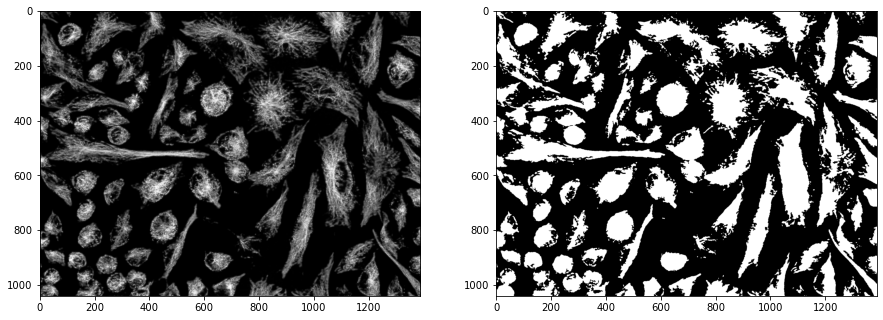

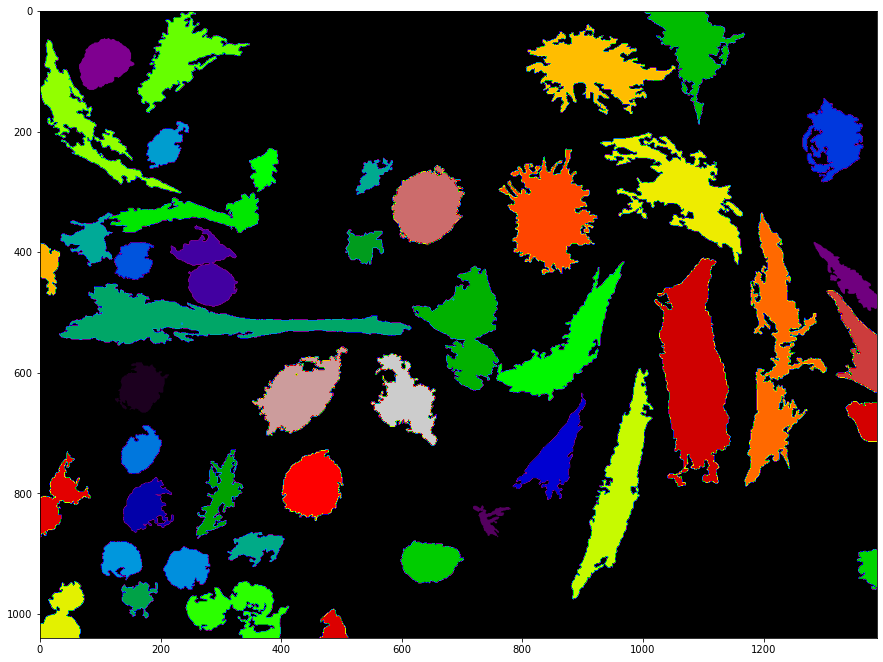

In [96]:
from scipy import ndimage as ndi
from skimage.segmentation import watershed
from skimage.feature import peak_local_max

from skimage.morphology import area_closing

row = DeconvDF.loc[11]
image = row['Image'] / np.max(row['Image'])
n_cents = len(Centroids[row.name])


thresh = threshold_otsu(image)
binary = image > thresh*0.9

closed = area_closing(binary, 10000)
#closed = area_closing(texture, 1000)

plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.imshow(image,cmap='gray')
plt.subplot(1,2,2)
plt.imshow(closed,cmap='gray')
plt.show()

distance = ndi.distance_transform_edt(closed)
coords = peak_local_max(distance, footprint=np.ones((200, 200)), labels=closed)
mask = np.zeros(distance.shape, dtype=bool)
mask[tuple(coords.T)] = True

markers, _ = ndi.label(mask)

markers = np.zeros_like(image)
l = 1
for index,row_ in Centroids[row.name].iterrows():
    markers[int(row_['Centroid'][0]),int(row_['Centroid'][1])] = l
    l+=1
    

labels = watershed(-distance, markers, mask=closed,watershed_line=True)

plt.figure(figsize=(15,15))
#plt.imshow(-distance, cmap=plt.cm.gray)
plt.imshow(labels, cmap=plt.cm.nipy_spectral)
plt.show()

## 5.x Plot proposed texture fields

In [21]:
s = 1
plt.figure(figsize=(13,5*len(TextureDF)))
for index, row in TextureDF.iterrows():
    # DECONVOLUTED
    plt.subplot(len(TextureDF),2,s)
    plt.imshow(DeconvDF['Image'][index],cmap='gray')
    plt.axis('off')
    plt.title("DECONVOLUTED - Mutation: " + row['Label'] + " / image ID: " + str(index),fontsize=10)
    s += 1
    plt.tight_layout()
    
    # TEXTURE FIELDS
    plt.subplot(len(TextureDF),2,s)
    plt.imshow(row['Image'],cmap='gray')
    plt.axis('off')
    plt.title("PROPOSED TEXTURAL FIELD - Mutation: " + row['Label'] + " / image ID: " + str(index),fontsize=10)
    s += 1
    plt.tight_layout() 
    

KeyError: (7786,)

ValueError: Image size of 936x8994240 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 936x8.99424e+06 with 1 Axes>

## 5.x Hough transform

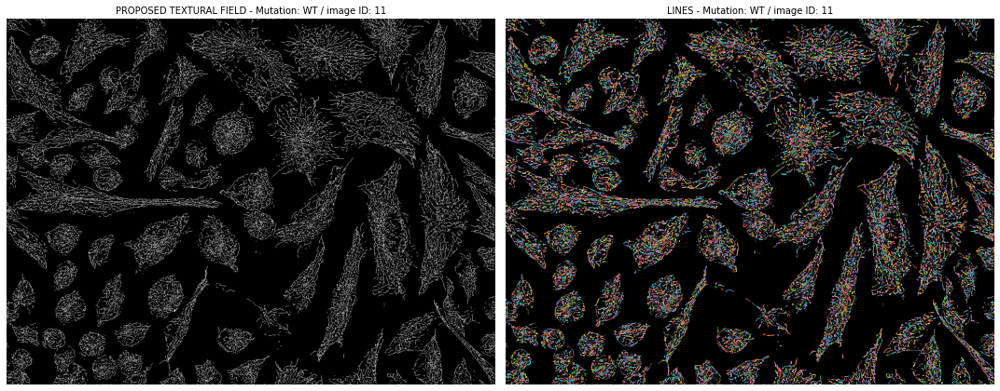

11 done


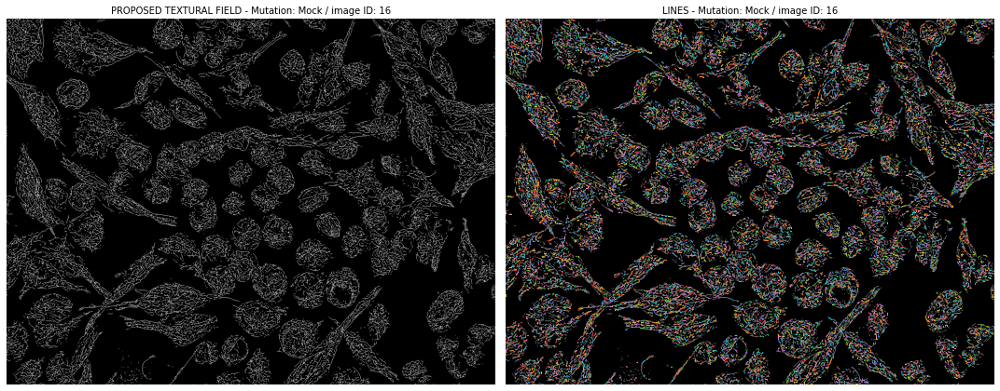

16 done


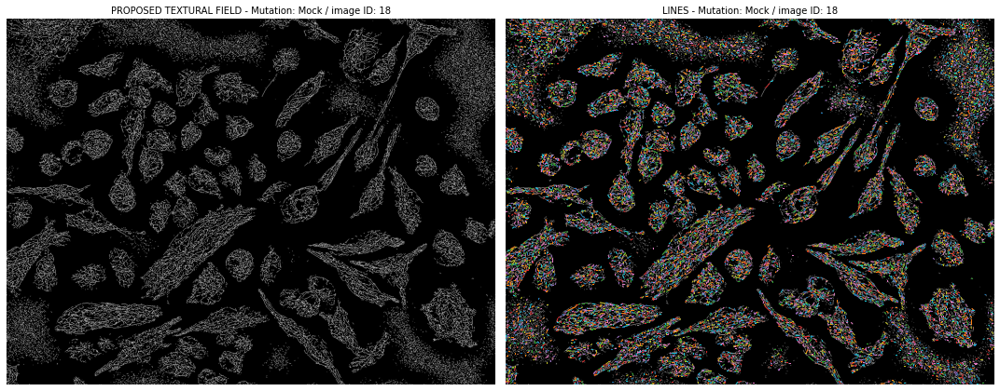

18 done


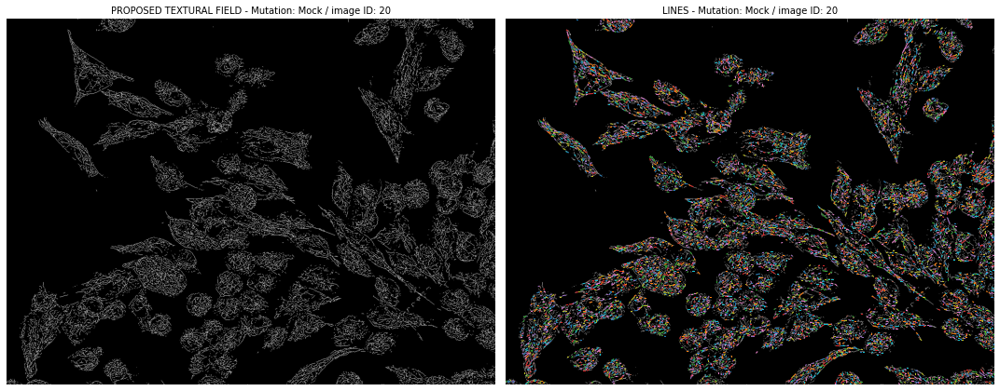

20 done


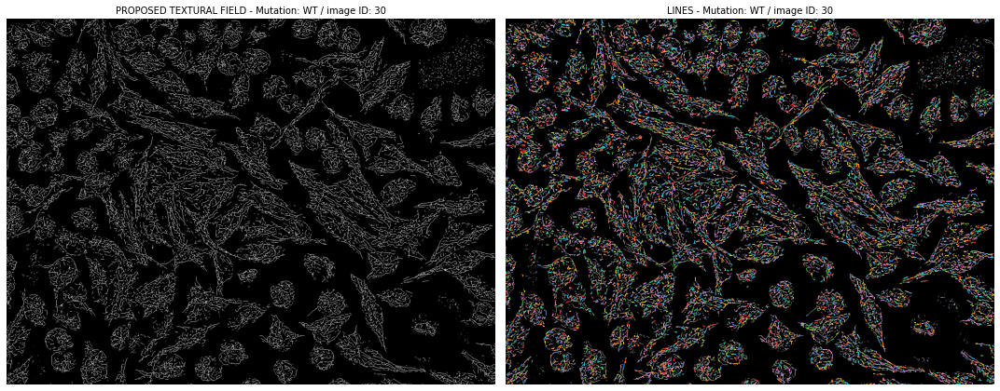

30 done


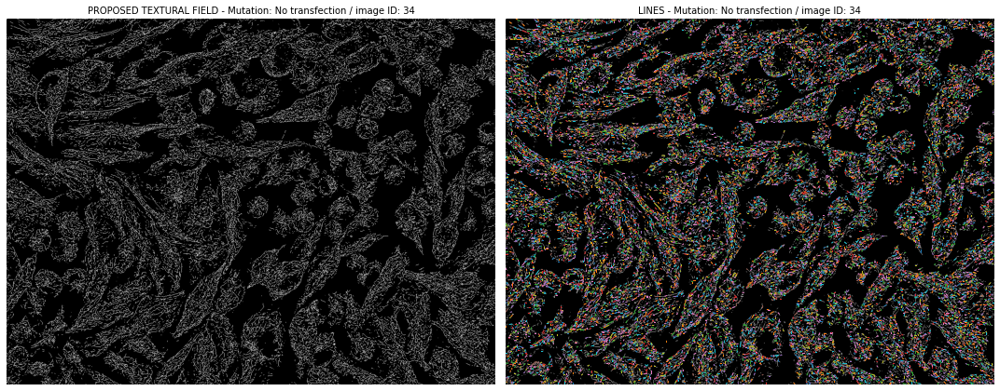

34 done


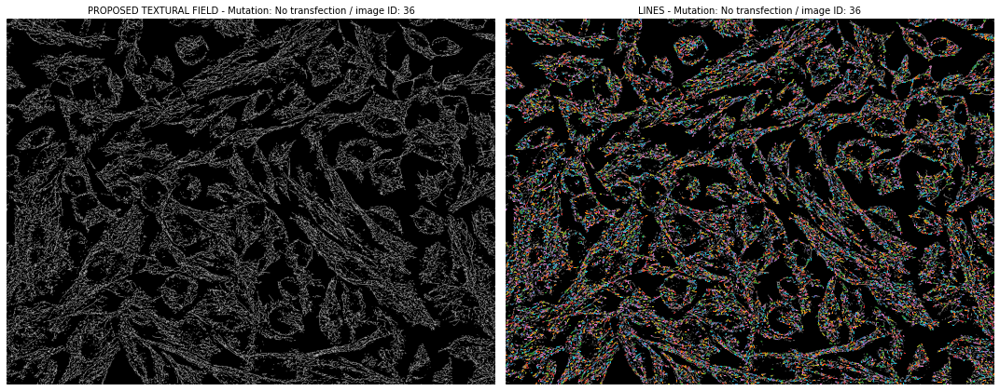

36 done


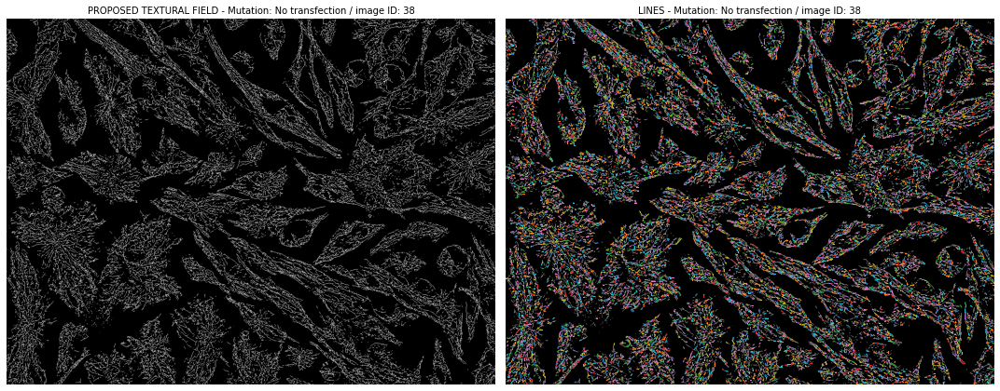

38 done


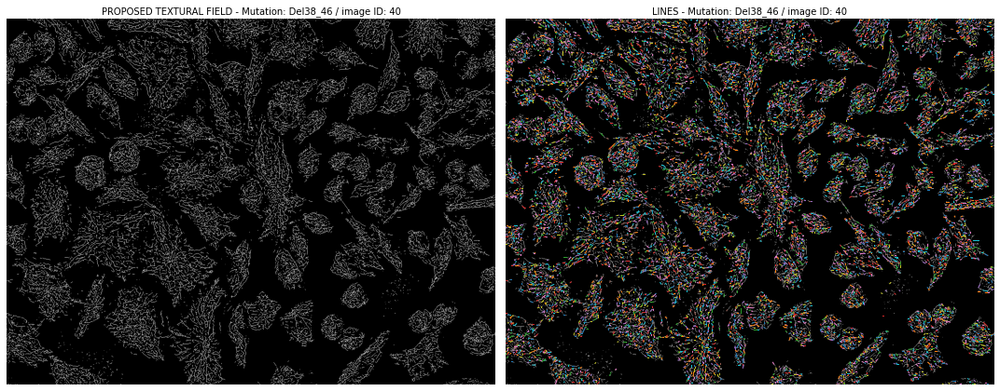

40 done


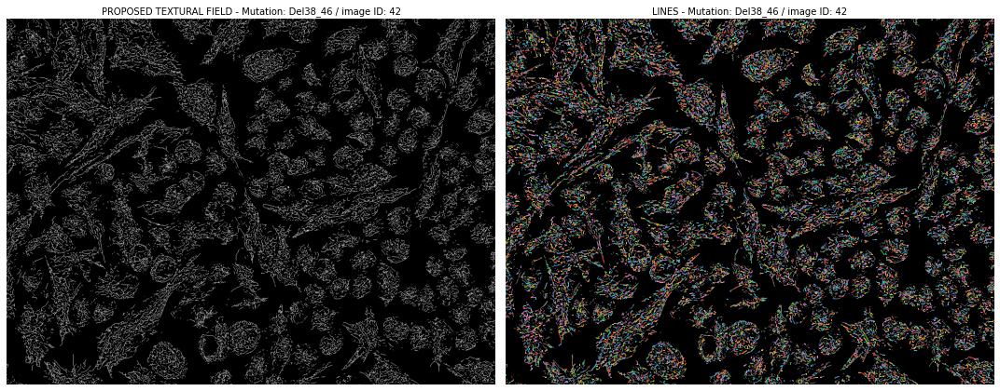

42 done


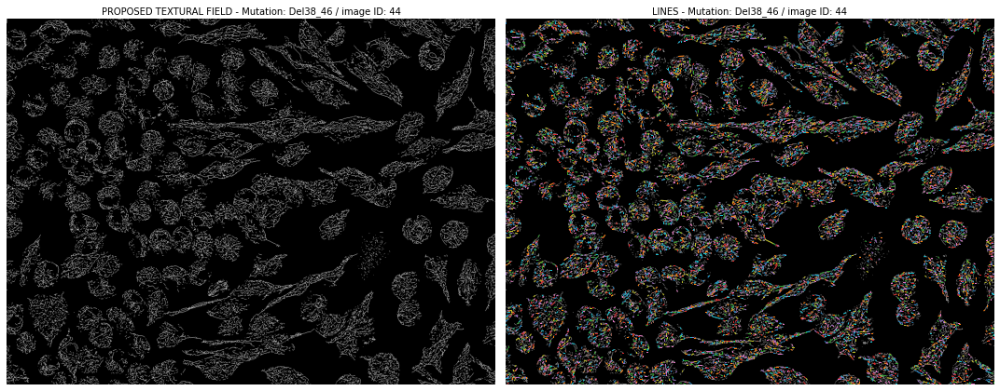

44 done


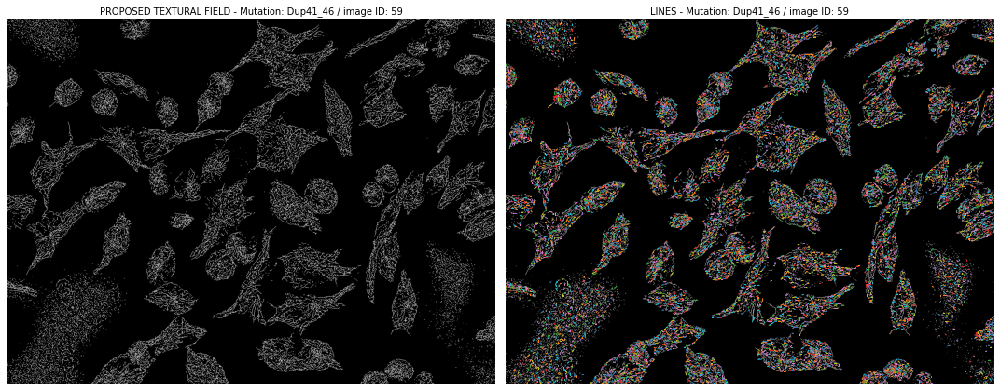

59 done


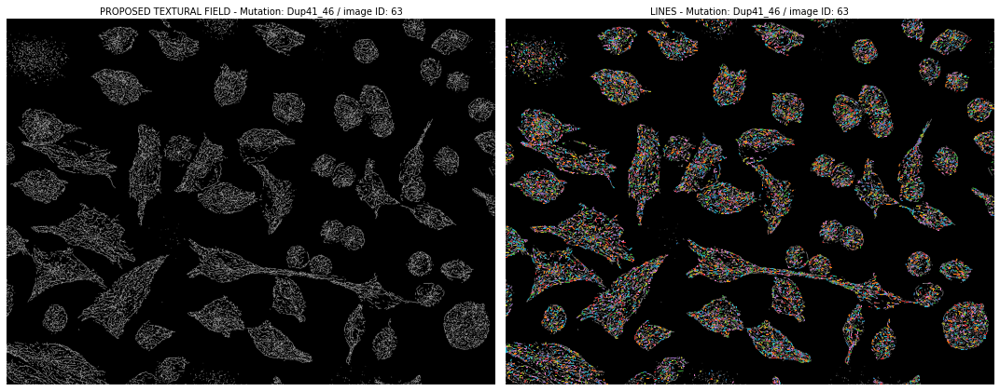

63 done


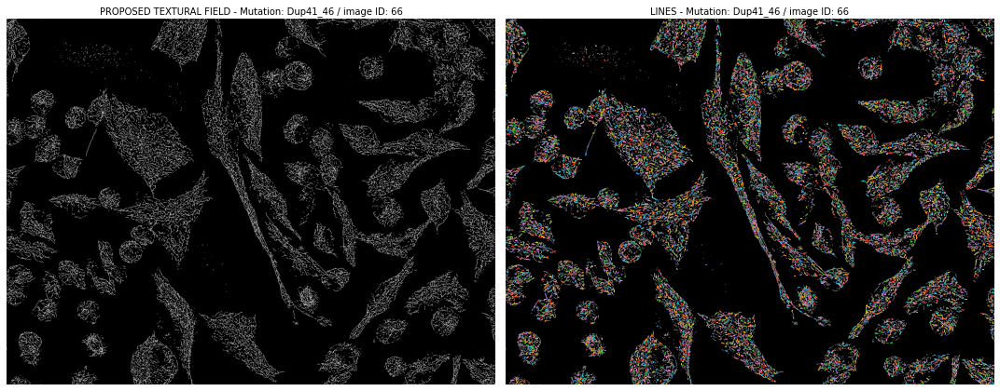

66 done


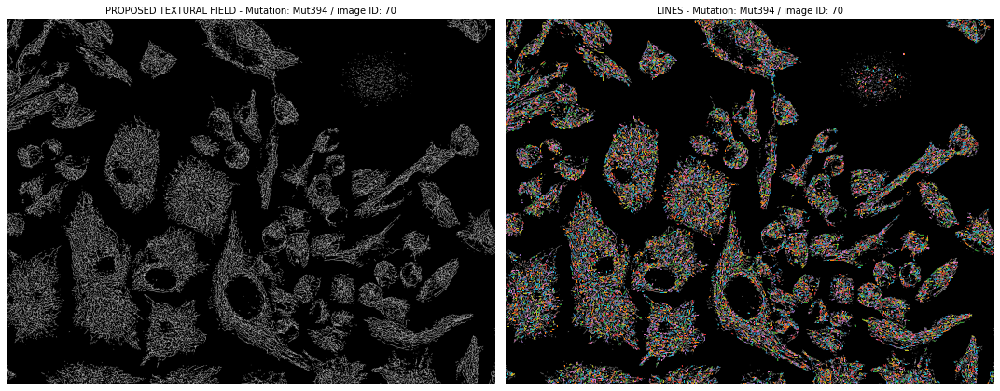

70 done


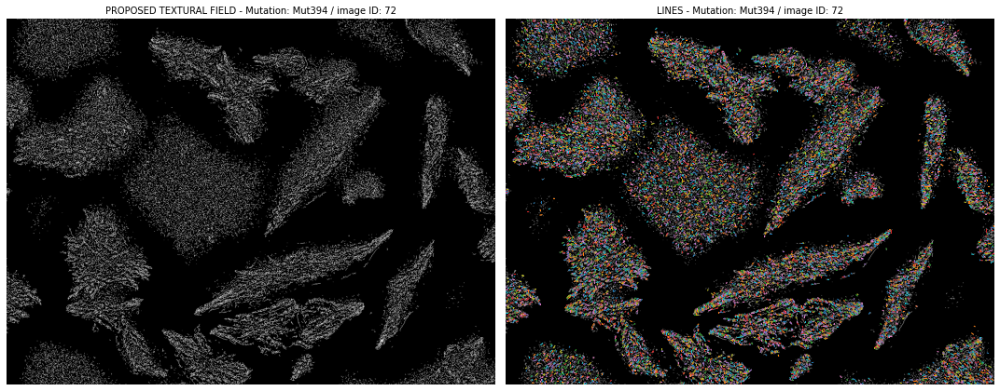

72 done


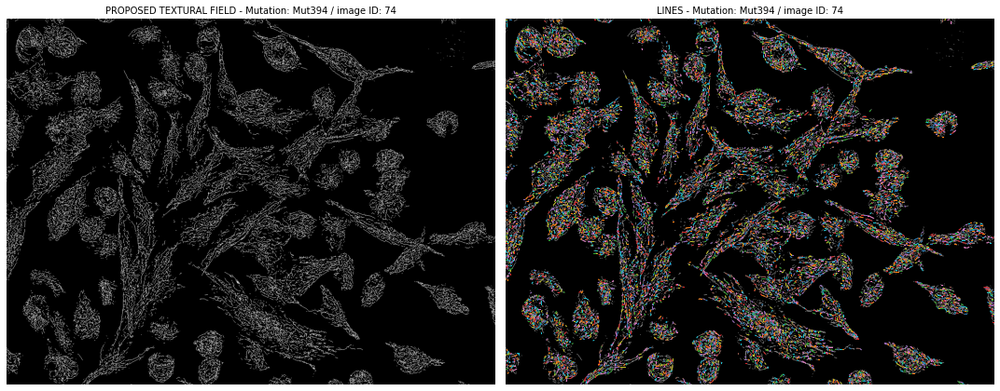

74 done


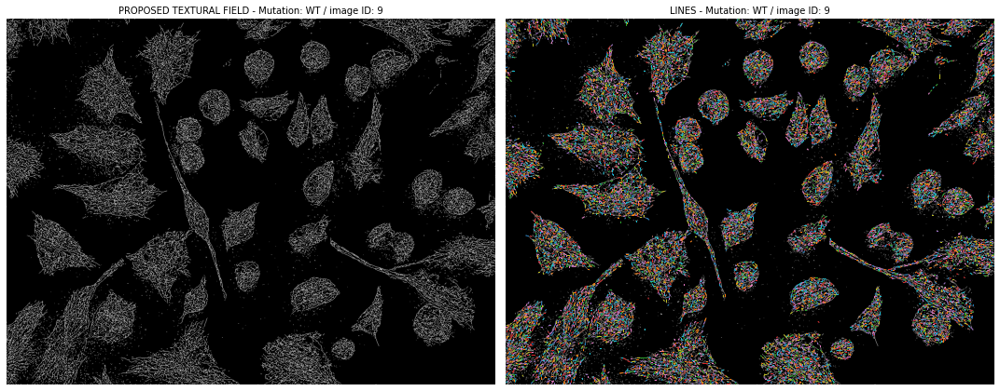

9 done


In [149]:
s = 1
#plt.figure(figsize=(15,5*len(TextureDF)))
#HoughDF = pd.DataFrame(columns=['Name','Label','Lines'])

for index, row in TextureDF.iterrows():
    plt.figure(figsize=(15,15))
    
    # TEXTURE FIELDS
    plt.subplot(1,2,1)
    plt.imshow(row['Image'],cmap='gray')
    plt.axis('off')
    plt.title("PROPOSED TEXTURAL FIELD - Mutation: " + row['Label'] + " / image ID: " + str(index),fontsize=10)
    s += 1
    plt.tight_layout()  
    
    # LINES
    plt.subplot(1,2,2)
    plt.imshow(row['Image'],cmap='gray')
    plt.axis('off')
    plt.title("LINES - Mutation: " + row['Label'] + " / image ID: " + str(index),fontsize=10)
    
    # Hough transform
    threshold   = 0
    line_length = 2
    line_gap    = 1
    #lines       = probabilistic_hough_line(row['Image'], threshold=threshold, line_length=line_length, line_gap=line_gap)
    lines = cv2toski(cv2.HoughLinesP(row['Image'].astype(np.uint8), rho=1., theta=np.pi/180., threshold=0, minLineLength=2, maxLineGap=1))
    
    # Add lines to DataFrame
    #new     = pd.DataFrame(data={'Name': [row['Name']], 'Label': [row['Label']], 'Lines': [lines]}, index = [index])
    #HoughDF = HoughDF.append(new,ignore_index=False)
        
    #Plot lines
    for line in lines:
        p0, p1 = line
        plt.plot((p0[0], p1[0]), (p0[1], p1[1]), linewidth=1)
    plt.tight_layout()
    
    # Next plot
    #s += 1
    #plt.savefig(".//TextureVSHough2//" + str(index) + ".png",format='png',transparent=True,bbox_inches='tight',dpi=200)
    plt.show()
     
    print(str(index) + ' done')

## 5.x Plot Deconvoluted, Texture Field and Line Segments

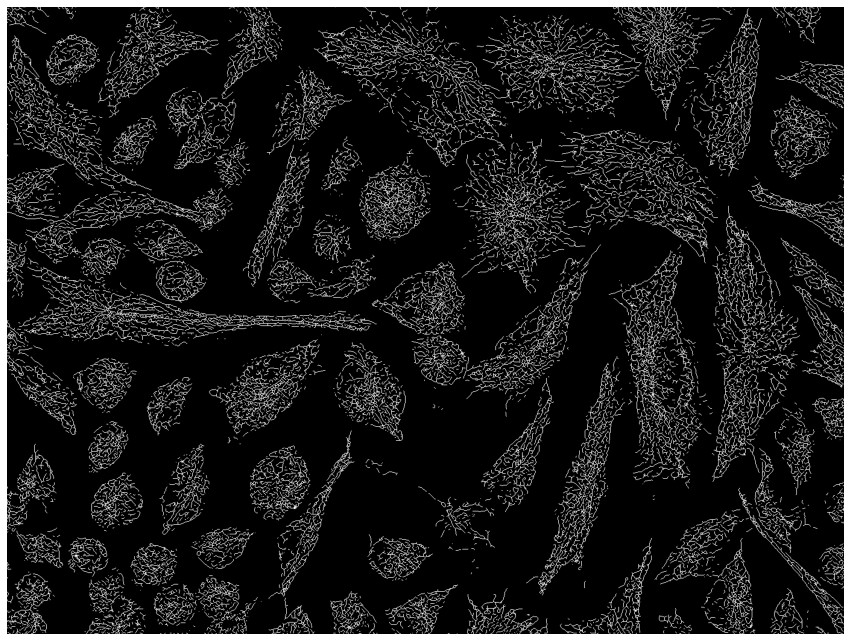

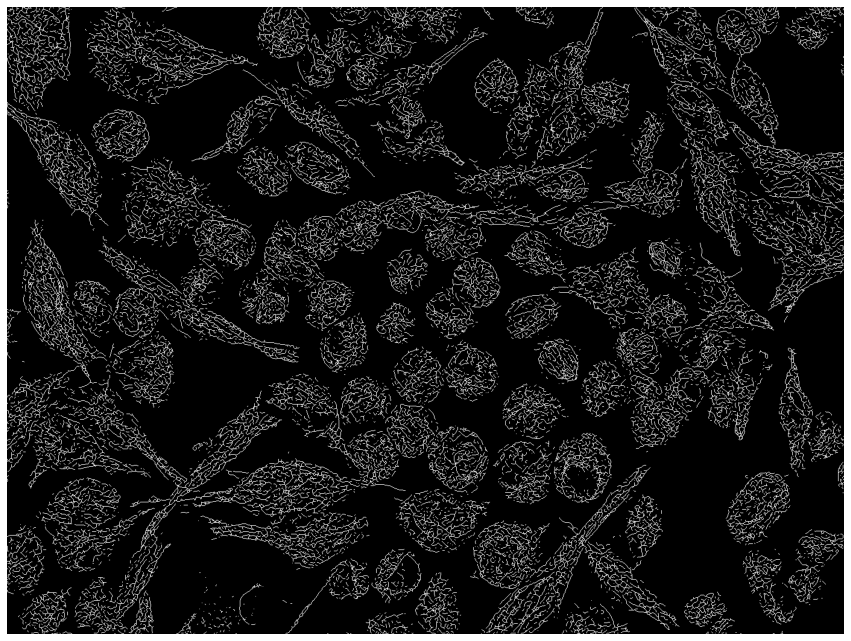

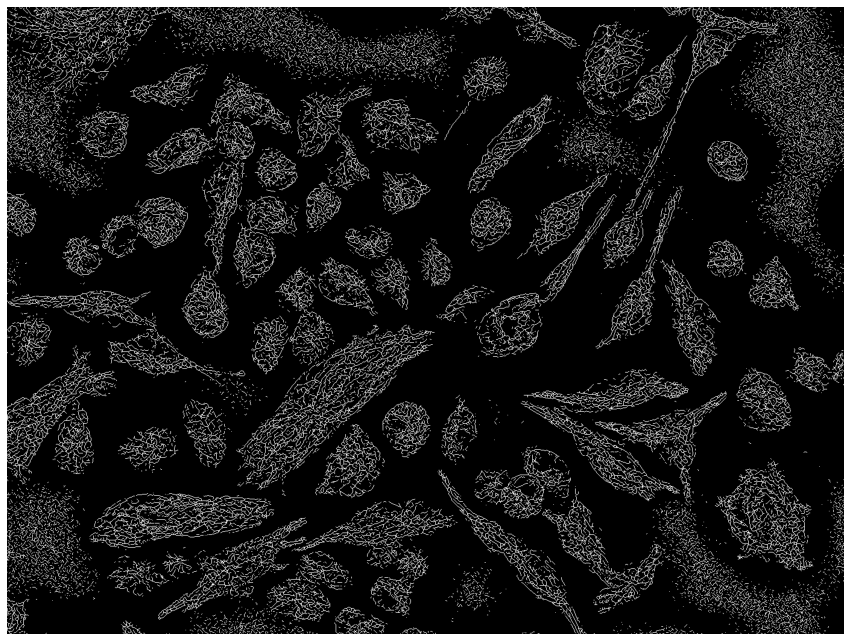

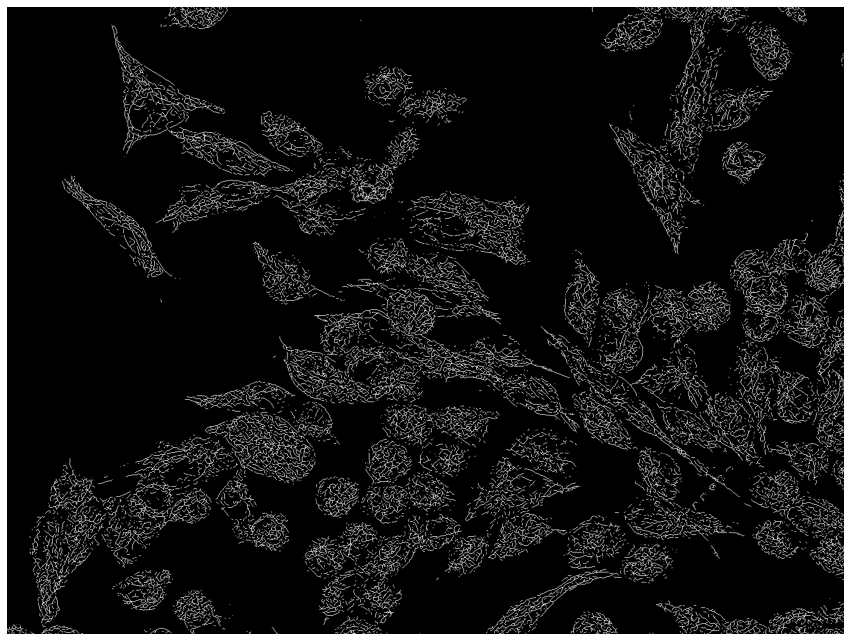

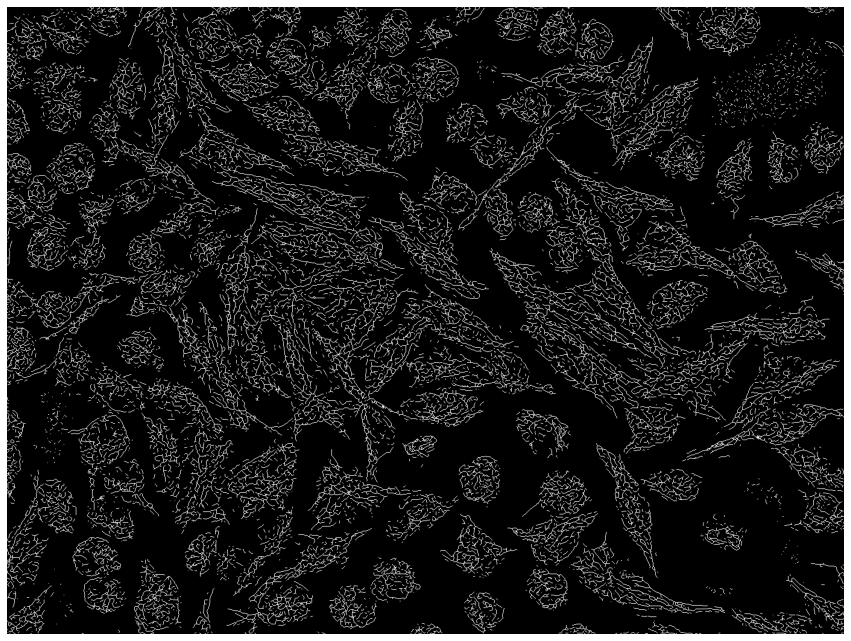

...

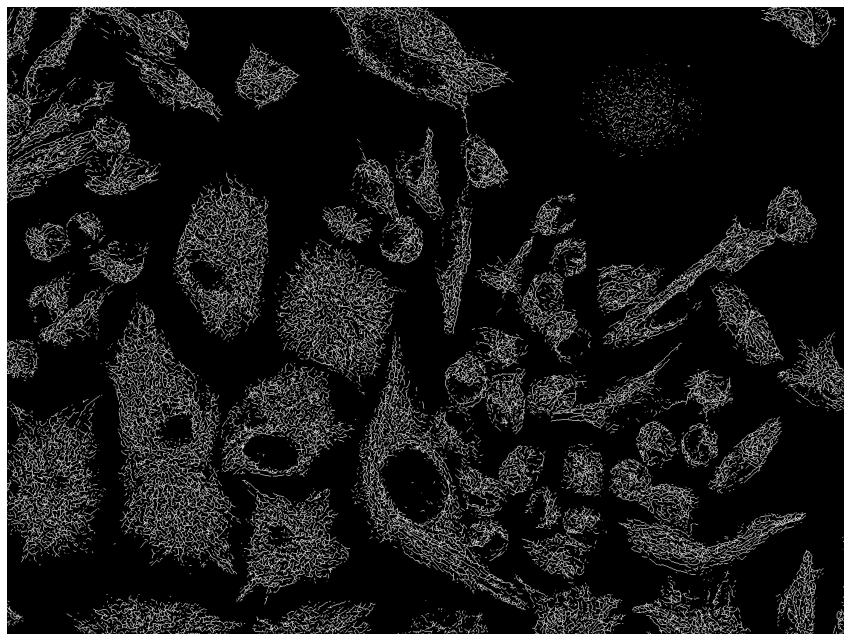

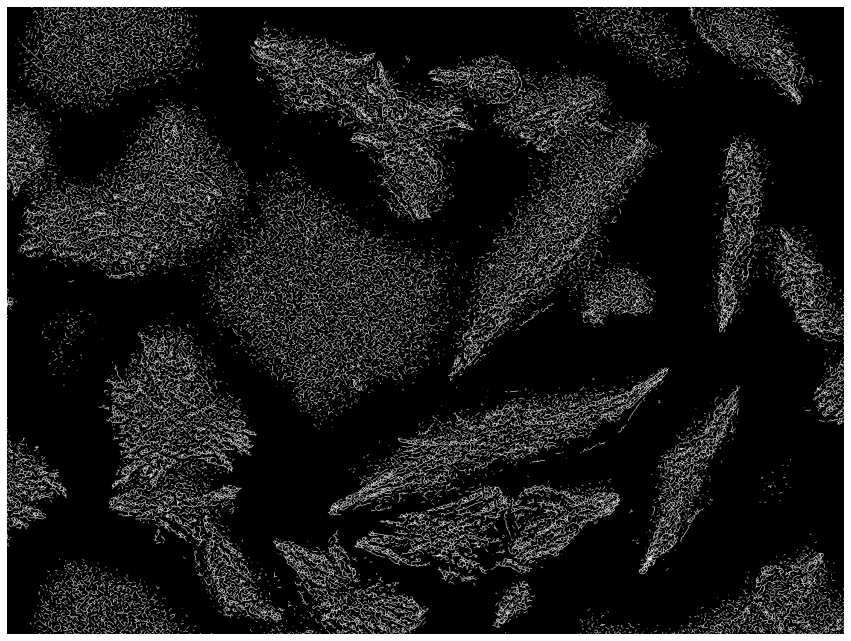

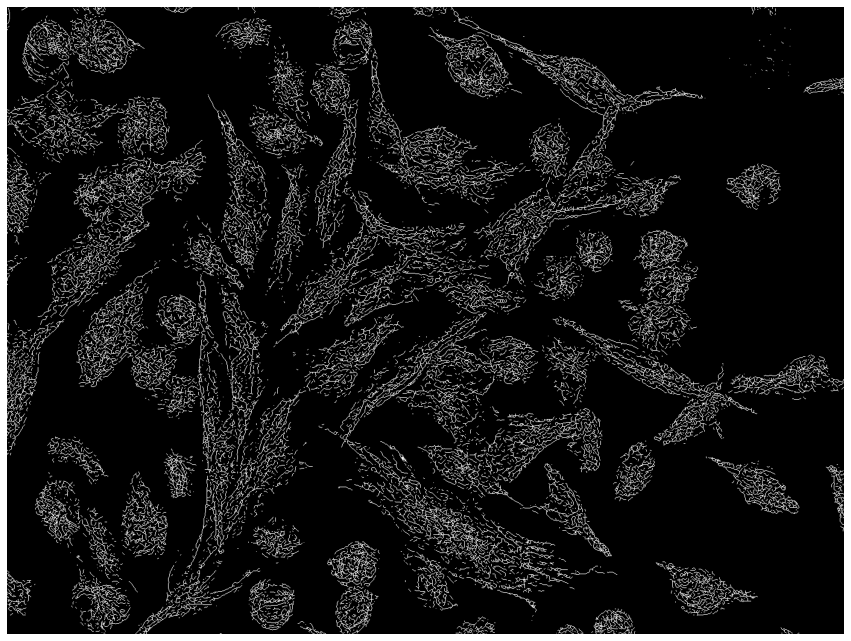

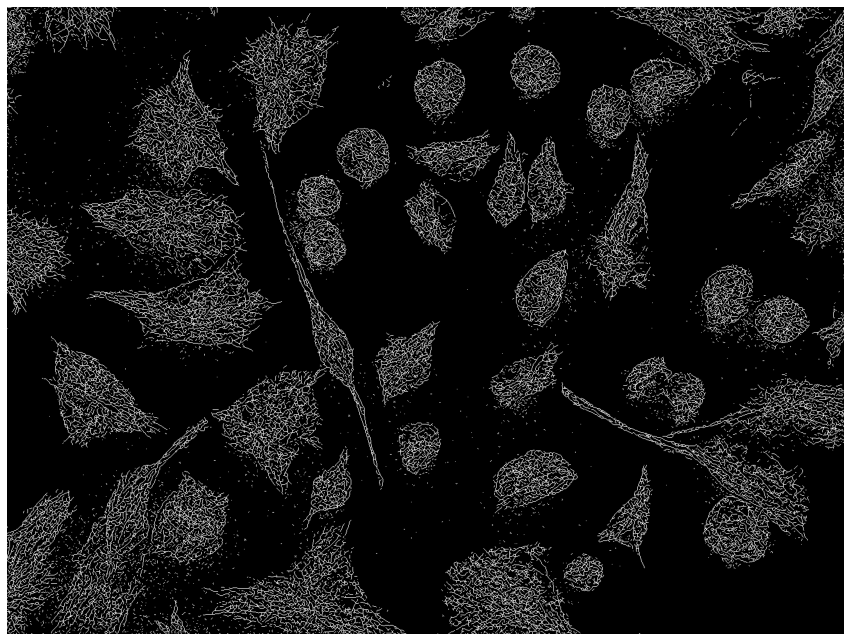

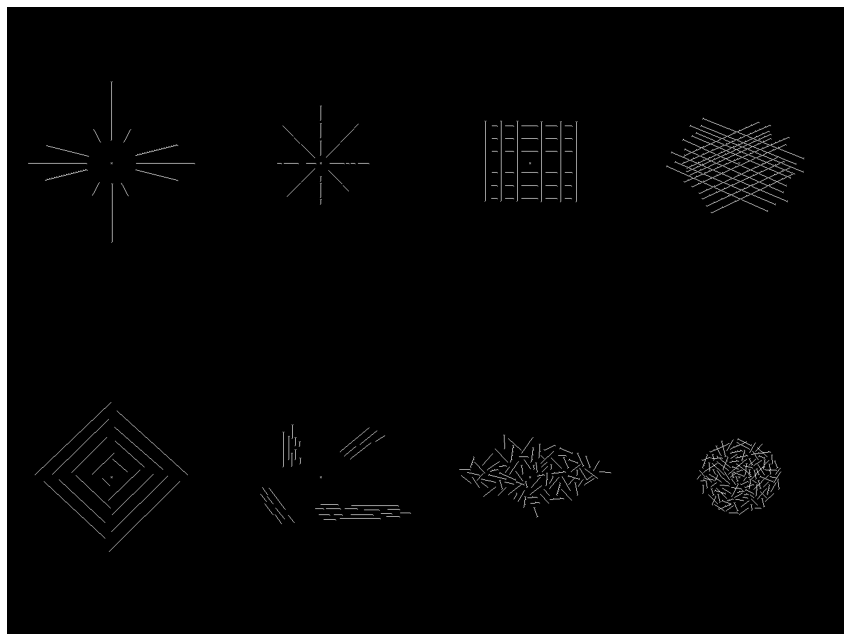

In [17]:
for index, row in TextureDF.iterrows():
    #plt.figure(figsize=(15,30))
    plt.figure(figsize=(15,15))
    
#     # DECONVOLUTED
#     plt.subplot(3,1,1)
#     plt.imshow(DeconvDF['Image'][index],cmap='gray')
#     plt.axis('off')
#     plt.tight_layout()
    
    # TEXTURE FIELDS
    #plt.subplot(3,1,2)
    plt.imshow(row['Image'],cmap='gray')
    plt.axis('off')
    #plt.tight_layout() 
    
#     # LINE SEGMENTS
#     plt.subplot(3,1,3)
#     lines = probabilistic_hough_line(row['Image'], threshold = 0,line_length = 3, line_gap=1)
#     plt.imshow(row['Image'] * 0,cmap='gray')
#     for line in lines:
#         p0, p1 = line
#         plt.plot((p0[0], p1[0]), (p0[1], p1[1]),linewidth=1)
#     plt.axis('off')
#     plt.tight_layout()
    
    plt.savefig("./textfields/" + str(index) + "_mutation_" + str(row['Label']) + "_skeleton.png",format='png',transparent=True,bbox_inches='tight',dpi=1200)
    plt.show()

# TEST

In [212]:
cents = Centroids[9]['Centroid'].tolist()
d = distance_matrix(cents,cents)

np.fill_diagonal(d,np.max(d))

np.where(d == d.min())[0]

array([ 1, 41], dtype=int64)

In [211]:
d[1][41]

48.073958917851776

In [218]:
print(cents[1])
print(cents[41])
res = ((cents[1][0] + cents[41][0])/2,(cents[1][1] + cents[41][1])/2)
res

(943.6851275668948, 952.6235220908525)
(897.2071428571429, 940.3392857142857)


(920.4461352120188, 946.4814039025691)

In [10]:
Centroids = OrderedDict()

for img in os.listdir(dir_masks):
    # Get image
    path     = dir_masks + '/' + img
    nuc_mask = cv2.imread(path,-1)
    
    # Initialize DataFrame to put the Centroids in:
    isolated_nucleus = pd.DataFrame(columns=['ID','Mask With ID','Centroid'])
    
    # Obtain isolated nucleus
    for nucleus in np.unique(nuc_mask):
        if nucleus != 0: #Not background
            
            # Obtain isolated nucleus
            aux  = nuc_mask == nucleus
            mask_w_id = aux*nuc_mask
            bin_nuclei = np.where(mask_w_id>0.5, 1, 0)

            # Calculate Centroid Position
            props    = regionprops(bin_nuclei,bin_nuclei)
            centroid = props[0].centroid 
            
            # Add new nucleus if area of nucleus is > 10
            if props[0].area > 150:
                new   = pd.DataFrame(data={'ID': [nucleus], 'Mask With ID': [mask_w_id], 'Centroid': [centroid]})
                isolated_nucleus = isolated_nucleus.append(new,ignore_index=True)
                
                # Treat nearby centroids
                if len(isolated_nucleus) > 0:
                    cents = isolated_nucleus['Centroid'].tolist()
                    d = distance_matrix(cents,cents)
                    np.fill_diagonal(d,np.max(d))
                    
                    if d.min() < 100
                    np.where(d == d.min())[0]
                    
    
    # Add Centroids obtained from the image to dict:
    Centroids[int(img.split('_')[1])] = isolated_nucleus

SyntaxError: invalid syntax (Temp/ipykernel_7364/2256333403.py, line 35)

In [11]:
Centroids = OrderedDict()

for img in os.listdir(dir_masks):
    # Get image
    path     = dir_masks + '/' + img
    nuc_mask = cv2.imread(path,-1)
    
    # Initialize DataFrame to put the Centroids in:
    isolated_nucleus = pd.DataFrame(columns=['ID','Mask With ID','Centroid'])
    
    # Obtain isolated nucleus
    for nucleus in np.unique(nuc_mask):
        if nucleus != 0: #Not background
            
            # Obtain isolated nucleus
            aux  = nuc_mask == nucleus
            mask_w_id = aux*nuc_mask
            bin_nuclei = np.where(mask_w_id>0.5, 1, 0)

            # Calculate Centroid Position
            props    = regionprops(bin_nuclei,bin_nuclei)
            centroid = props[0].centroid 
            
            # Add new nucleus if area of nucleus is > 10
            if props[0].area > 600:
                new   = pd.DataFrame(data={'ID': [nucleus], 'Mask With ID': [mask_w_id], 'Centroid': [centroid]})
                isolated_nucleus = isolated_nucleus.append(new,ignore_index=True)
    
    # Add Centroids obtained from the image to dict:
    Centroids[int(img.split('_')[1])] = isolated_nucleus

Centroid Index: 0 Complete: 0.0%
Centroid Index: 5 Complete: 5.747126436781609%
Centroid Index: 10 Complete: 11.494252873563218%
Centroid Index: 15 Complete: 17.24137931034483%
Centroid Index: 20 Complete: 22.988505747126435%
Centroid Index: 25 Complete: 28.735632183908045%
Centroid Index: 30 Complete: 34.48275862068966%
Centroid Index: 35 Complete: 40.229885057471265%
Centroid Index: 40 Complete: 45.97701149425287%
Centroid Index: 45 Complete: 51.724137931034484%
Centroid Index: 50 Complete: 57.47126436781609%
Centroid Index: 55 Complete: 63.2183908045977%
Centroid Index: 60 Complete: 68.96551724137932%
Centroid Index: 65 Complete: 74.71264367816092%
Centroid Index: 70 Complete: 80.45977011494253%
Centroid Index: 75 Complete: 86.20689655172414%
Centroid Index: 80 Complete: 91.95402298850574%
Centroid Index: 85 Complete: 97.70114942528735%
Image 11 done.


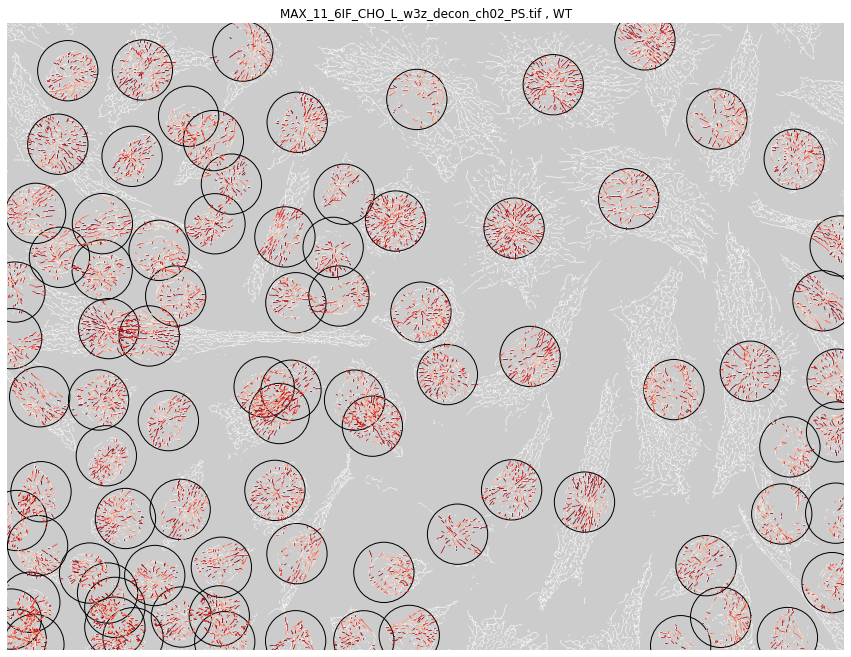

Centroid Index: 0 Complete: 0.0%
Centroid Index: 5 Complete: 3.816793893129771%
Centroid Index: 10 Complete: 7.633587786259542%
Centroid Index: 15 Complete: 11.450381679389313%
Centroid Index: 20 Complete: 15.267175572519085%
Centroid Index: 25 Complete: 19.083969465648856%
Centroid Index: 30 Complete: 22.900763358778626%
Image 16 does not have calculated centroids.
Centroid Index: 0 Complete: 0.0%
Image 18 does not have calculated centroids.
Image 20 does not have calculated centroids.
Centroid Index: 0 Complete: 0.0%
Image 30 does not have calculated centroids.
Centroid Index: 0 Complete: 0.0%
Image 34 does not have calculated centroids.
Image 36 does not have calculated centroids.
Centroid Index: 0 Complete: 0.0%
Image 38 does not have calculated centroids.
Image 40 does not have calculated centroids.
Image 42 does not have calculated centroids.
Centroid Index: 0 Complete: 0.0%
Image 44 does not have calculated centroids.
Image 59 does not have calculated centroids.
Image 63 does no

KeyboardInterrupt: 

In [109]:
# Initialize Dictionary
LinesOD = OrderedDict()
for condition in np.unique(TextureDF['Label']):
    LinesOD[condition] = []

plot = True

#n_images = 1
for index,row in TextureDF.iterrows():
    try:
        if plot:
            plt.figure(figsize=(15,15))
            #plt.subplot(len(HoughDF),1,s)
            #plt.imshow(row['Image'] * 0, cmap='gray')
            plt.imshow(row['Image'],cmap='gray',alpha=0.2)
            plt.title(row['Name'] + " , " + row['Label'])
            plt.axis('off')

        #lines_aux = copy.deepcopy(row['Lines'])

        ImageLinesDF = pd.DataFrame(columns = ['Name'] + ['Label'] + ['Angles'] + ['Distances to Centroid'] + ['Triangle Areas'] + ['Line Lengths'] + ['Fractal Dim'])

        for index_c,row_c in Centroids[index].iterrows():

            # Get features around centroid
            ImageLinesDF = FeaturesFromCentroid(image=[row['Image'],index,row['Name'],row['Label']],index_c=index_c,centroid=row_c['Centroid'],radius=50,threshold=0,line_length=2,line_gap=1,ImageLinesDF=ImageLinesDF,plot=True)

            # Print progress
            if index_c%5 == 0:
                print("Centroid Index: " + str(index_c) + " Complete: " + str((index_c*100)/len(Centroids[index])) + "%")

        # Add Feature Matrix to the label's entry in OrderedDict 
        LinesOD[row['Label']] = LinesOD[row['Label']] + [ImageLinesDF]

        # Keep track of progress
        print('Image ' + str(index) + ' done.')

        #plt.savefig(".//more//" + str(index) + ".png",format='png',transparent=True,bbox_inches='tight',dpi=250)
        plt.show()

    except:
        print('Image ' + str(index) + ' does not have calculated centroids.')
    
#     n_images += 1
#     if n_images == 2:
#         break


ipykernel_launcher.py (33): 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


ValueError: The dimension of bins must be equal to the dimension of the  sample x.

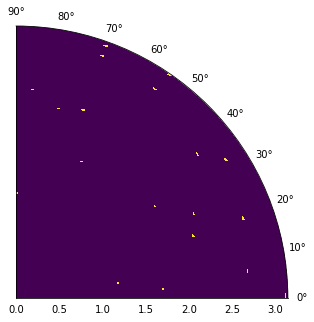

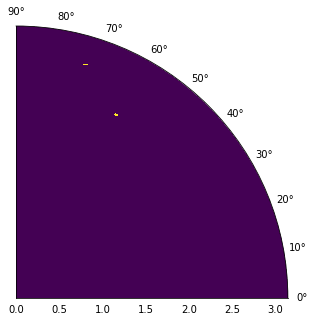

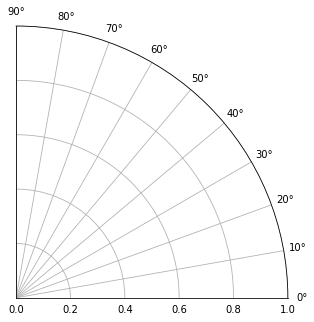

In [72]:
labels = list(LinesMut.keys())
feats  = ['Angles', 'Distances to Centroid']
colors = ['#3498DB','#E74C3C','#95A5A6','#ABE6FF','#CA6F1E','#2ECC71']

#fig = plt.figure(figsize=(10,10)) 
#ax = fig.add_subplot(projection='3d')

    
aux_angles = pd.DataFrame(columns = labels)
aux_dists  = pd.DataFrame(columns = labels)

for label in labels:
    fig = plt.figure(figsize=(5,5)) 
    ax = fig.add_subplot(111, polar=True)
    ax.set_thetamin(0)
    ax.set_thetamax(90)
    
    #FEAT1
    feat_concat_angles = []
    for a in LinesMut[label][feats[0]]:
        feat_concat_angles += a
    aux_angles[label] = pd.Series(feat_concat_angles)
    
    # FEAT2
    feat_concat_dists  = []
    for d in LinesMut[label][feats[1]]:
        feat_concat_dists += d
    aux_dists[label] = pd.Series(feat_concat_dists)
    


    
    dist_edges = np.linspace(0, 40, 35+1)
    angs_edges = np.linspace(0, np.pi/2, 90+1)
    
    histog_, angs, dists = np.histogram2d(np.array(aux_dists[label][~np.isnan(aux_dists[label])]),np.array(aux_angles[label][~np.isnan(aux_angles[label])]), [dists_edges, angs_edges])
    #plt.hist2d(np.array(aux_angles[label][~np.isnan(aux_angles[label])]), np.array(aux_dists[label][~np.isnan(aux_dists[label])]), bins=20)
    
    
    
    #histog_angles = np.histogram(np.array(aux[label][~np.isnan(aux[label])]),bins=15)
    #xedges, yedges = yedges*np.cos(xedges), yedges*np.sin(xedges)
    histog_ = histog_/np.trapz(histog[0],x=histog[1][:-1])
    angs, dists = np.meshgrid(angs_edges, dists_edges)
    #angs, dists = dists*np.cos(angs), dists*np.sin(angs)
    
    #ax.pcolormesh(angs, dists, histog_, label = label,alpha=0.3,color=colors[labels.index(label)])
    ax.pcolormesh(angs, dists, histog_)

    #plt.plot(histog[1][:-1],histog[0],color=colors[labels.index(label)],linewidth=4,label = label,alpha=0.7)
    #plt.plot(histog[1][:-1],histog[0]/(histog[0].sum()),color=colors[labels.index(label)],linewidth=4,label = label,alpha=0.7)


#ax.legend()
#plt.grid(alpha=0.3)
#plt.ylabel('Distance to Centroid',fontsize=12)
#plt.xlabel('Angles',fontsize=12)
#plt.title('Histogram - ' + feat,fontsize=20)
plt.show()


In [11]:
# Widget Types
dropdown_image = widgets.Dropdown(description =  'Select Image:' , options = DeconvDF.index)
label_text = widgets.Text(value='', description='Label:', disabled=True)
dropdown_and_label = widgets.HBox([dropdown_image, label_text])
radiobuttons_original = widgets.RadioButtons(options=['all','red', 'blue', 'green'], description='Select channel:')
slider_texture = widgets.IntSlider(min=1,max=1000,step=100,description='Gamma:',value=500)
slider_nbhd_radius = widgets.IntSlider(min=5,max=100,step=5,description='Radius:',value=50)
slider_nbhd_linelen = widgets.IntSlider(min=2,max=15,step=1,description='Line Length:',value=3)
sliders_nbhd = widgets.HBox([slider_nbhd_radius, slider_nbhd_linelen])
button_neigh = widgets.Button(value=False, description='Calculate', disabled=False, button_style='')
dropdown_centroids = widgets.Dropdown(description =  'Select Centroid:' , options = [str(round(x[0],2)) + "," + str(round(x[1],2)) for x in Centroids[img_id]['Centroid']])

# Outputs
output_original      = widgets.Output()
output_deconv        = widgets.Output()
output_texture       = widgets.Output()
output_nuclei        = widgets.Output()
output_neighbourhood = widgets.Output()
output_plots         = widgets.Output()


# Event Handler Functions
def radiobuttons_original_eventhandler(change):
    output_original.clear_output()
    image = OriginalDF['Image'][dropdown_image.value]
    copia = copy.deepcopy(OriginalDF['Image'][dropdown_image.value])
    if change.new == 'all' or radiobuttons_original.value == 'all':
        copia[:,:,0] = image[:,:,2]
        copia[:,:,2] = image[:,:,0]
    if change.new == 'red':
        copia[:,:,0] = image[:,:,2]
        copia[:,:,1] = 0
        copia[:,:,2] = 0
    if change.new == 'green':
        copia[:,:,0] = 0
        copia[:,:,1] = image[:,:,1]
        copia[:,:,2] = 0
    if change.new == 'blue':
        copia[:,:,0] = 0
        copia[:,:,1] = 0
        copia[:,:,2] = image[:,:,0]
    
    with output_original:
        plt.figure(figsize=(15,15))
        plt.imshow(copia,cmap='gray')
        plt.axis('off')
        plt.show()
        display(radiobuttons_original)
        
def slider_texture_eventhandler(change):
    # Get Texture
    texture,skeleton,TextureDF = img_getTexture(image=[DeconvDF['Image'][dropdown_image.value], dropdown_image.value, DeconvDF['Name'][dropdown_image.value], DeconvDF['Label'][dropdown_image.value]], sigmas=[0.03], gamma=slider_texture.value, algorithm=1,TextureDF=0,to_add='null')

    with output_texture:
        output_texture.clear_output()
        
        plt.figure(figsize=(15,15))
        plt.imshow(texture,cmap='gray')
        plt.axis('off')
        plt.show()
        
        plt.figure(figsize=(15,15))
        plt.imshow(skeleton,cmap='gray')
        plt.axis('off')
        plt.show()
        
        display(slider_texture)

def test(change):
    a = 2
                                    
def slider_nbhd_eventhandler(change):
    output_neighbourhood.clear_output()
    img = TextureDF['Image'][dropdown_image.value]
    
    with output_neighbourhood:
        plt.figure(figsize=(15,15))
        plt.imshow(img,cmap='gray',alpha=0.2)
        plt.axis('off')
        
        WholeImageLinesDF = pd.DataFrame(columns = ['Name'] + ['Label'] + ['Angles'] + ['Distances to Centroid'] + ['Triangle Areas'] + ['Line Lengths'])

        for index_c,row_c in Centroids[dropdown_image.value].iterrows():
            
            # Get features around centroid
            WholeImageLinesDF = FeaturesFromCentroid(image=[img,index],index_c=index_c,centroid=row_c['Centroid'],radius=slider_nbhd_radius.value,threshold=0,line_length=slider_nbhd_linelen.value,line_gap=1,ImageLinesDF=WholeImageLinesDF,plot=True)

            if index_c%5 == 0:
                print("Centroid Index: " + str(index_c) + " Complete: " + str((index_c*100)/len(Centroids[dropdown_image.value])) + "%")


        plt.show()
        #display(slider_nbhd_radius)
        #display(slider_nbhd_linelen)
        display(sliders_nbhd)
        display(button_neigh)
    #return ImageLinesDF
    
def dropdown_plots_eventhandler(change):
    img = TextureDF['Image'][dropdown_image.value]
    output_plots.clear_output()
    with output_plots:
        display(dropdown_centroids)
        plt.figure(figsize=(5,5))
        plt.imshow(img,cmap='gray',alpha=0.2)
        plt.axis('off')
        
        Centroid = tuple(dropdown_centroids.value)
        Centroid = dropdown_centroids.value.split(",")
        Centroid = (float(Centroid[0]),float(Centroid[1]))
        
        ImageLinesDF = pd.DataFrame(columns = ['Name'] + ['Label'] + ['Angles'] + ['Distances to Centroid'] + ['Triangle Areas'] + ['Line Lengths'])

        # Get features around centroid
        #ImageLinesDF = FeaturesFromCentroid(image=img,index=index,index_c=0,centroid=Centroid,radius=slider_nbhd_radius.value,threshold=0,line_length=slider_nbhd_linelen.value,line_gap=1,ImageLinesDF=ImageLinesDF,plot=True)
        ImageLinesDF = FeaturesFromCentroid(image=[img,index],index_c=0,centroid=Centroid,radius=slider_nbhd_radius.value,threshold=0,line_length=slider_nbhd_linelen.value,line_gap=1,ImageLinesDF=ImageLinesDF,plot=True)
        
        # GET HISTOGRAMS
        feats  = list(ImageLinesDF.columns[2:])
        colors = ['#3498DB','#E74C3C','#95A5A6','#ABE6FF','#CA6F1E','#2ECC71']

        s=1
        plt.figure(figsize=(6,4*len(feats)))
        for feat in feats: 

            histog = np.histogram(np.array(ImageLinesDF[feat][0]),bins=30)

            plt.subplot(len(feats),1,s)
            #plt.plot(histog[1][:-1],histog[0],color=colors[labels.index(label)],linewidth=4,label = label,alpha=0.7)
            #plt.subplot(len(feats)+1,2,s+1)
            #plt.plot(histog[1][:-1],histog[0]/(histog[0].sum()),color=colors[labels.index(label)],linewidth=4,label = label,alpha=0.7)
            #plt.plot(histog[1][:-1],(histog[0]-histog[0].min())/(histog[0].max()-histog[0].min()),color=colors[labels.index(label)],linewidth=4,label = label,alpha=0.7)
            if feat == 'Distances to Centroid':
                aux2 = []
                for i in range(len(histog[1])-1):
                    aux2 += [np.pi*(histog[1][i+1])**2 - np.pi*(histog[1][i])**2]
                plt.plot(histog[1][:-1],(histog[0]/np.trapz(histog[0],x=histog[1][:-1]))/aux2,linewidth=4,alpha=0.7)
                #plt.plot(histog[1][:-1],histog[0]/np.trapz(histog[0],x=histog[1][:-1]),color=colors[labels.index(label)],linewidth=4,label = label,alpha=0.7)

            else:
                plt.plot(histog[1][:-1],histog[0]/np.trapz(histog[0],x=histog[1][:-1]),linewidth=4,alpha=0.7)

            #if feat == 'Triangle Areas':
                #plt.xlim([-5, 80])

            #if feat == 'Line Lengths':
                #plt.xlim([1.5, 10])
            
    
            #plt.subplot(len(feats),1,s)
            plt.grid(alpha=0.3)
            plt.ylabel('Probability',fontsize=16)
            if feats.index(feat) == 0:
                plt.xlabel('Angles (º)')
            if feats.index(feat) == 1:
                plt.xlabel('Pixels')
            if feats.index(feat) == 2:
                plt.xlabel('Pixels')
            plt.title('Histogram - ' + feat,fontsize=20)
            plt.tight_layout()

            #plt.subplot(len(feats)+1,2,s+1)
            #plt.legend()
            #plt.grid(alpha=0.3)
            plt.title('Probability Density Function - ' + feat,fontsize=20)
            #plt.tight_layout()

            s += 1
            
        plt.show()

def dropdown_image_eventhandler(change):
    output_original.clear_output()
    output_deconv.clear_output()
    output_texture.clear_output()
    output_nuclei.clear_output()
    output_neighbourhood.clear_output()
    output_plots.clear_output()
    #img_id = dropdown_image.value
    label_text.value = DeconvDF['Label'][dropdown_image.value]
    
    with output_original:
        #display(radiobuttons_original)
        radiobuttons_original_eventhandler(change)
    with output_deconv:
        plt.figure(figsize=(15,15))
        plt.imshow(DeconvDF['Image'][change.new],cmap='gray')
        plt.axis('off')
        plt.show()
    with output_texture:
        #display(slider_texture)
        slider_texture_eventhandler(change)
    with output_nuclei:
        plt.figure(figsize=(15,15))
        plt.imshow(NucleiDeconvDF['Image'][change.new],cmap='gray')
        plt.axis('off')
        for index_c,row_c in Centroids[change.new].iterrows():
            plt.plot(row_c['Centroid'][1],row_c['Centroid'][0],'o',color='red',markersize=7)
        plt.show()
    with output_neighbourhood:
        #display(slider_nbhd_radius)
        #display(slider_nbhd_linelen)
        display(sliders_nbhd)
        display(button_neigh)
        #slider_nnbhd_eventhandler(change)
        #button_neigh.on_click(slider_nbhd_eventhandler)
    with output_plots:
        display(dropdown_centroids)
        #dropdown_plots_eventhandler(change)
        

    
# OBSERVE    
radiobuttons_original.observe(radiobuttons_original_eventhandler, names='value')
dropdown_image.observe(dropdown_image_eventhandler, names='value')
slider_texture.observe(slider_texture_eventhandler, names='value')
slider_nbhd_radius.observe(test, names='value')
slider_nbhd_linelen.observe(test, names='value')
button_neigh.observe(slider_nbhd_eventhandler, names='value')
dropdown_centroids.observe(dropdown_plots_eventhandler, names='value')
                               
# Display initial widgets
display(dropdown_and_label)

with output_neighbourhood:
    button_neigh.on_click(slider_nbhd_eventhandler)

# Tabs
tab = widgets.Tab([output_original, output_deconv, output_texture, output_nuclei, output_neighbourhood, output_plots])
tab.set_title(0, 'Original')
tab.set_title(1, 'Deconvoluted')
tab.set_title(2, 'Texture')
tab.set_title(3, 'Nuclei')
tab.set_title(4, 'Neighbourhood')
tab.set_title(5, 'Plots')
display(tab)

In [45]:
LinesMut = copy.deepcopy(LinesOD)

for mut in LinesOD.keys():
    # Remove 'Name' and 'Label' columns
    if LinesOD[mut] != []:

        for dataset in range(len(LinesOD[mut])):
            LinesOD[mut][dataset] = LinesOD[mut][dataset].drop(LinesOD[mut][dataset].columns[[0, 1]],axis=1)

        # Concatenate datasets
        LinesMut[mut] = pd.concat(LinesOD[mut], ignore_index=True)

In [46]:
pickle.dump(LinesMut, open('contour_linelength2_5feats.p', 'wb'))

In [13]:
labels = list(LinesMut.keys())
feats  = list(LinesMut[labels[0]].columns)
colors = ['#3498DB','#E74C3C','#95A5A6','#ABE6FF','#CA6F1E','#2ECC71']

s=1
plt.figure(figsize=(20,10*len(feats)))
for feat in feats: 
    
    #aux = pd.DataFrame(columns = labels)
    for label in labels:
        feat_concat = []
        for x in LinesMut[label][feat]:
            feat_concat += x
            
        #aux[label] = pd.Series(feat_concat)



        #histog = np.histogram(np.array(feat_concat[~np.isnan(feat_concat)]),bins=30)
        histog = np.histogram(np.array(feat_concat),bins=30)
        
        
        
        plt.subplot(len(feats),1,s)
        #plt.plot(histog[1][:-1],histog[0],color=colors[labels.index(label)],linewidth=4,label = label,alpha=0.7)
        #plt.subplot(len(feats)+1,2,s+1)
        #plt.plot(histog[1][:-1],histog[0]/(histog[0].sum()),color=colors[labels.index(label)],linewidth=4,label = label,alpha=0.7)
        #plt.plot(histog[1][:-1],(histog[0]-histog[0].min())/(histog[0].max()-histog[0].min()),color=colors[labels.index(label)],linewidth=4,label = label,alpha=0.7)
        if feat == 'Distances to Centroid':
            aux2 = []
            for i in range(len(histog[1])-1):
                aux2 += [np.pi*(histog[1][i+1])**2 - np.pi*(histog[1][i])**2]
            plt.plot(histog[1][:-1],(histog[0]/np.trapz(histog[0],x=histog[1][:-1]))/aux2,color=colors[labels.index(label)],linewidth=4,label = label,alpha=0.7)
            #plt.plot(histog[1][:-1],histog[0]/np.trapz(histog[0],x=histog[1][:-1]),color=colors[labels.index(label)],linewidth=4,label = label,alpha=0.7)
            
        else:
            plt.plot(histog[1][:-1],histog[0]/np.sum(histog[0]),color=colors[labels.index(label)],linewidth=4,label = label,alpha=0.7)
        
        if feat == 'Triangle Areas':
            plt.xlim([-5, 80])
        
        if feat == 'Line Lengths':
            #plt.xlim([1.5, 10])
            o = 2

            
    
    #plt.subplot(len(feats),1,s)
    plt.legend()
    plt.grid(alpha=0.3)
    plt.ylabel('Probability',fontsize=16)
    if feats.index(feat) == 0:
        plt.xlabel('Angles (º)')
    if feats.index(feat) == 1:
        plt.xlabel('Pixels')
    if feats.index(feat) == 2:
        plt.xlabel('Pixels')
    plt.title('Histogram - ' + feat,fontsize=20)
    plt.tight_layout()
    
    #plt.subplot(len(feats)+1,2,s+1)
    #plt.legend()
    #plt.grid(alpha=0.3)
    plt.title('Probability Density Function - ' + feat,fontsize=20)
    #plt.tight_layout()
    
    s += 1


NameError: name 'LinesMut' is not defined

In [ ]:
# Widget Types
dropdown_image = widgets.Dropdown(description =  'Select Image:' , options = DeconvDF.index)
label_text = widgets.Text(value='', description='Label:', disabled=True)
dropdown_and_label = widgets.HBox([dropdown_image, label_text])
slider_texture = widgets.IntSlider(min=1,max=1000,step=100,description='Gamma:',value=500)
texture, skeleton, filt_contours, contour_out, contour_int = img_getTexture([(255*(DeconvDF['Image'][dropdown_image.value]/np.max(DeconvDF['Image'][dropdown_image.value]))).astype(np.uint8),index,DeconvDF['Name'][dropdown_image.value],DeconvDF['Label'][dropdown_image.value]], sigmas=[0.03], gamma=slider_texture.value, algorithm='contour',TextureDF=TextureDF,to_add='null')
dropdown_contours = widgets.Dropdown(description =  'Select Contour:', options = list(range(len(filt_contours))))


# Outputs
output_deconv        = widgets.Output()
output_texture       = widgets.Output()
output_cont_int      = widgets.Output()
output_nuclei        = widgets.Output()
output_analyze_cont  = widgets.Output()

# Event Handler Functions     
def slider_texture_eventhandler(change):
    # Get Texture
    #texture,skeleton,TextureDF = img_getTexture(image=[DeconvDF['Image'][dropdown_image.value], dropdown_image.value, DeconvDF['Name'][dropdown_image.value], DeconvDF['Label'][dropdown_image.value]], sigmas=[0.03], gamma=slider_texture.value, algorithm=1,TextureDF=0,to_add='null')
    texture, skeleton, filt_contours, contour_out, contour_int = img_getTexture([(255*(DeconvDF['Image'][dropdown_image.value]/np.max(DeconvDF['Image'][dropdown_image.value]))).astype(np.uint8),index,DeconvDF['Name'][dropdown_image.value],DeconvDF['Label'][dropdown_image.value]], sigmas=[0.03], gamma=slider_texture.value, algorithm='contour',TextureDF=TextureDF,to_add='null')
 
    with output_texture:
        output_texture.clear_output()
        
        plt.figure(figsize=(15,15))
        plt.imshow(texture,cmap='gray')
        plt.axis('off')
        plt.show()
        
        plt.figure(figsize=(15,15))
        plt.imshow(skeleton,cmap='gray')
        plt.axis('off')
        plt.show()
        
        display(slider_texture)
        

def test(change):
    a = 2
    
def analyze_contour_eventhandler(change):
    texture, skeleton, filt_contours, contour_out, contour_int = img_getTexture([(255*(DeconvDF['Image'][dropdown_image.value]/np.max(DeconvDF['Image'][dropdown_image.value]))).astype(np.uint8),index,DeconvDF['Name'][dropdown_image.value],DeconvDF['Label'][dropdown_image.value]], sigmas=[0.03], gamma=slider_texture.value, algorithm='contour',TextureDF=TextureDF,to_add='null')
    with output_analyze_cont:
        output_analyze_cont.clear_output()
        display(dropdown_contours)
        analyze_contour(filt_contours[dropdown_contours.value],[texture,dropdown_image.value],[0,2,1],Centroids[dropdown_image.value]['Centroid'],True)
                                   
def dropdown_image_eventhandler(change):
    output_deconv.clear_output()
    output_texture.clear_output()
    output_nuclei.clear_output()
    output_cont_int.clear_output()
    label_text.value = DeconvDF['Label'][dropdown_image.value]
        
    with output_deconv:
        plt.figure(figsize=(15,15))
        plt.imshow(DeconvDF['Image'][change.new],cmap='gray')
        plt.axis('off')
        plt.show()
    with output_texture:
        slider_texture_eventhandler(change)
    with output_cont_int:
        texture, skeleton, filt_contours, contour_out, contour_int = img_getTexture([(255*(DeconvDF['Image'][dropdown_image.value]/np.max(DeconvDF['Image'][dropdown_image.value]))).astype(np.uint8),index,DeconvDF['Name'][dropdown_image.value],DeconvDF['Label'][dropdown_image.value]], sigmas=[0.03], gamma=slider_texture.value, algorithm='contour',TextureDF=TextureDF,to_add='null')
        plt.figure(figsize=(15,15))
        plt.imshow(contour_int,cmap='gray')
        plt.axis('off')
        plt.show()
    with output_nuclei:
        plt.figure(figsize=(15,15))
        plt.imshow(NucleiDeconvDF['Image'][change.new],cmap='gray')
        plt.axis('off')
        for index_c,row_c in Centroids[change.new].iterrows():
            plt.plot(row_c['Centroid'][1],row_c['Centroid'][0],'o',color='red',markersize=7)
        plt.show()
    with output_analyze_cont:
        texture, skeleton, filt_contours, contour_out, contour_int = img_getTexture([(255*(DeconvDF['Image'][dropdown_image.value]/np.max(DeconvDF['Image'][dropdown_image.value]))).astype(np.uint8),index,DeconvDF['Name'][dropdown_image.value],DeconvDF['Label'][dropdown_image.value]], sigmas=[0.03], gamma=slider_texture.value, algorithm='contour',TextureDF=TextureDF,to_add='null')
        #dropdown_contours = widgets.Dropdown(description =  'Select Contour:' , options = list(range(len(filt_contours))))
        display(dropdown_contours)
        analyze_contour_eventhandler(change)
        
        


# OBSERVE    
dropdown_image.observe(dropdown_image_eventhandler, names='value')
slider_texture.observe(slider_texture_eventhandler, names='value')
dropdown_contours.observe(analyze_contour_eventhandler, names='value')
                               
# Display initial widgets
display(dropdown_and_label)


# Tabs
tab = widgets.Tab([output_deconv, output_texture, output_cont_int, output_nuclei, output_analyze_cont])
tab.set_title(0, 'Deconvoluted')
tab.set_title(1, 'Texture')
tab.set_title(2, 'Contours')
tab.set_title(3, 'Nuclei')
tab.set_title(4, 'Analysis')
display(tab)